In [5]:
# %% [markdown]
# # Notebook 24: D2 manifest and visual QC for T2FS + ovary masks
#
# This notebook:
# 1. Scans the D2_TCPW folder for patients with both T2FS and ovary mask.
# 2. Builds a candidate manifest CSV.
# 3. Provides an interactive QC viewer to inspect all slices for each patient.

# %% 
import os
from pathlib import Path

import numpy as np
import pandas as pd
import nibabel as nib
import matplotlib.pyplot as plt

from ipywidgets import interact, IntSlider

# Make plots a bit bigger
plt.rcParams["figure.figsize"] = (6, 6)

# Project root is one level up from this notebook
project_root = Path("..").resolve()

# D2 dataset root
d2_root = project_root / "data" / "UT-EndoMRI" / "D2_TCPW"
print("D2 root:", d2_root)

assert d2_root.is_dir(), f"D2 root not found: {d2_root}"

data_dir = project_root / "data"
data_dir.mkdir(exist_ok=True)


D2 root: C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW


In [6]:
# %%
# Find patients that have BOTH T2FS and ovary mask

patient_dirs = sorted([p for p in d2_root.iterdir() if p.is_dir()])
print(f"Found {len(patient_dirs)} patient folders under D2_TCPW.")

rows = []

for patient_folder in patient_dirs:
    pid = patient_folder.name  # e.g., "D2-000"
    t2fs_path = patient_folder / f"{pid}_T2FS.nii.gz"
    ov_path   = patient_folder / f"{pid}_ov.nii.gz"

    if t2fs_path.exists() and ov_path.exists():
        rows.append(
            {
                "patient_id": pid,
                "t2fs_path": str(t2fs_path),
                "ov_mask_path": str(ov_path),
            }
        )
    else:
        # Helpful debug output
        missing = []
        if not t2fs_path.exists():
            missing.append("T2FS")
        if not ov_path.exists():
            missing.append("ov")
        print(f"Skipping {pid}: missing {', '.join(missing)}")

manifest_df = pd.DataFrame(rows)

if manifest_df.empty:
    print("\nNo candidates found – check filename patterns and paths.")
else:
    manifest_df = manifest_df.sort_values("patient_id").reset_index(drop=True)
    print(f"\nFound {len(manifest_df)} patients with BOTH T2FS and ov masks.\n")
    display(manifest_df.head())


Found 73 patient folders under D2_TCPW.
Skipping D2-002: missing ov
Skipping D2-004: missing ov
Skipping D2-006: missing ov
Skipping D2-041: missing ov
Skipping D2-049: missing ov
Skipping D2-053: missing ov
Skipping D2-062: missing ov
Skipping D2-063: missing T2FS
Skipping D2-064: missing ov
Skipping D2-066: missing ov
Skipping D2-067: missing ov
Skipping D2-068: missing T2FS
Skipping D2-069: missing T2FS, ov
Skipping D2-071: missing ov
Skipping D2-077: missing ov
Skipping D2-079: missing ov
Skipping D2-080: missing ov

Found 56 patients with BOTH T2FS and ov masks.



,patient_id,t2fs_path,ov_mask_path
0,D2-000,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...
1,D2-001,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...
2,D2-003,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...
3,D2-005,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...
4,D2-007,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...


In [7]:
# %%
# Save the candidate manifest so we can reuse it later

output_path = data_dir / "d2_manifest_t2fs_ov_candidates.csv"

if manifest_df.empty:
    print("Manifest is empty – not saving CSV.")
else:
    manifest_df.to_csv(output_path, index=False)
    print(f"Saved candidate manifest to: {output_path}")


Saved candidate manifest to: C:\Users\lytten\programming\dlvr-project\data\d2_manifest_t2fs_ov_candidates.csv


In [8]:
# %%
def load_patient_volumes(patient_id, manifest=manifest_df):
    """
    Load T2FS volume and ovary mask volume for a given patient_id
    using the candidate manifest.
    """
    row = manifest.loc[manifest["patient_id"] == patient_id]
    if row.empty:
        raise ValueError(f"Patient {patient_id} not found in manifest.")

    t2fs_path = Path(row.iloc[0]["t2fs_path"])
    ov_path = Path(row.iloc[0]["ov_mask_path"])

    img = nib.load(str(t2fs_path))
    msk = nib.load(str(ov_path))

    img_data = img.get_fdata()
    msk_data = msk.get_fdata()

    # Sanity checks
    if img_data.shape != msk_data.shape:
        print("WARNING: Image and mask shapes differ:",
              img_data.shape, msk_data.shape)

    return img_data, msk_data


In [27]:
def plot_patient_row(patient_id, manifest=manifest_df, vmax_cols=None):
    """
    Plot all slices with non-zero ovary mask for a given patient in one row.

    If image and mask have different numbers of slices, we:
      - print a warning,
      - only consider the overlapping slice range,
      - and recommend excluding this patient later.
    """
    img, msk = load_patient_volumes(patient_id, manifest)

    img_slices = img.shape[2]
    msk_slices = msk.shape[2]

    if img_slices != msk_slices:
        print(
            f"WARNING: {patient_id} image/mask slice mismatch: "
            f"img={img_slices}, mask={msk_slices}. "
            "Using overlapping slices only (this patient is a good candidate for exclusion)."
        )

    # Only consider the overlapping range to avoid IndexError
    n_slices = min(img_slices, msk_slices)

    # Find slices with any ovary mask within the overlapping range
    mask_slice_indices = [k for k in range(n_slices) if np.any(msk[:, :, k] > 0)]

    if len(mask_slice_indices) == 0:
        print(f"{patient_id}: no slices with ovary mask > 0, skipping.")
        return

    if vmax_cols is not None:
        mask_slice_indices = mask_slice_indices[:vmax_cols]

    n_cols = len(mask_slice_indices)

    # Normalise image volume for display
    img_min, img_max = np.percentile(img, [1, 99])
    img_norm = np.clip((img - img_min) / (img_max - img_min + 1e-6), 0, 1)

    fig, axes = plt.subplots(
        1, n_cols, figsize=(3 * n_cols, 3),
        squeeze=False
    )
    axes = axes[0]

    for ax, k in zip(axes, mask_slice_indices):
        slice_img = img_norm[:, :, k].T
        slice_msk = msk[:, :, k].T

        ax.imshow(slice_img, cmap="gray", origin="lower")
        if np.any(slice_msk > 0):
            ax.imshow(
                np.ma.masked_where(slice_msk <= 0, slice_msk),
                cmap="autumn",
                alpha=0.5,
                origin="lower"
            )
        ax.set_axis_off()
        ax.set_title(f"{patient_id}\nz={k}", fontsize=8)

    plt.tight_layout()
    plt.show()


In [23]:
# %% [markdown]
# Updated QC viewer: only show slices that actually contain ovary mask voxels

# %%
def qc_patient(patient_id, manifest=manifest_df, only_mask_slices=True):
    """
    Interactive visual QC for one patient.
    
    By default, only shows slices that contain any ovary mask.
    
    Parameters
    ----------
    patient_id : str
        e.g. 'D2-001'
    manifest : pd.DataFrame
        Manifest with columns ['patient_id', 't2fs_path', 'ov_mask_path']
    only_mask_slices : bool
        If True, restrict slider to slices where mask > 0.
    """
    img, msk = load_patient_volumes(patient_id, manifest)
    
    # Assume axial slices along last axis (img[:, :, k])
    n_slices = img.shape[2]

    # Find slices with any ovary mask
    mask_slice_indices = [k for k in range(n_slices) if np.any(msk[:, :, k] > 0)]

    if only_mask_slices:
        indices = mask_slice_indices
        if len(indices) == 0:
            print(f"{patient_id}: no slices with ovary mask > 0.")
            return
        print(f"{patient_id}: showing {len(indices)} slices with ov mask "
              f"out of {n_slices} total.")
    else:
        indices = list(range(n_slices))
        print(f"{patient_id}: showing all {n_slices} slices "
              f"({len(mask_slice_indices)} have ov mask).")

    # Normalize image per volume for display
    img_min, img_max = np.percentile(img, [1, 99])
    img_norm = np.clip((img - img_min) / (img_max - img_min + 1e-6), 0, 1)

    def show_slice(idx):
        k = indices[idx]  # actual slice index in the volume

        plt.figure()
        plt.imshow(img_norm[:, :, k].T, cmap="gray", origin="lower")

        mask_slice = msk[:, :, k].T
        if np.any(mask_slice > 0):
            plt.imshow(
                np.ma.masked_where(mask_slice <= 0, mask_slice),
                cmap="autumn",
                alpha=0.5,
                origin="lower",
            )
        plt.axis("off")
        plt.title(f"{patient_id} – slice {k} (mask slice {idx+1}/{len(indices)})")
        plt.show()

    interact(
        show_slice,
        idx=IntSlider(min=0, max=len(indices) - 1, step=1, value=0),
    )


# Quick smoke test (only if we have any patients)
if not manifest_df.empty:
    example_pid = manifest_df.iloc[0]["patient_id"]
    print("Example patient for QC:", example_pid)
    # qc_patient(example_pid)  # uncomment to try
else:
    print("No patients in manifest – QC viewer not available.")


Example patient for QC: D2-000


In [24]:
qc_patient("D2-001")


D2-001: showing 2 slices with ov mask out of 34 total.


interactive(children=(IntSlider(value=0, description='idx', max=1), Output()), _dom_classes=('widget-interact'…

Patient D2-000


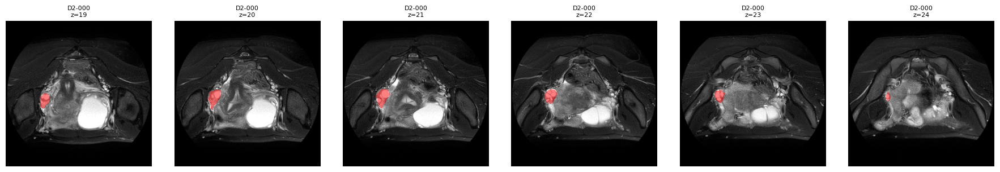

Patient D2-001


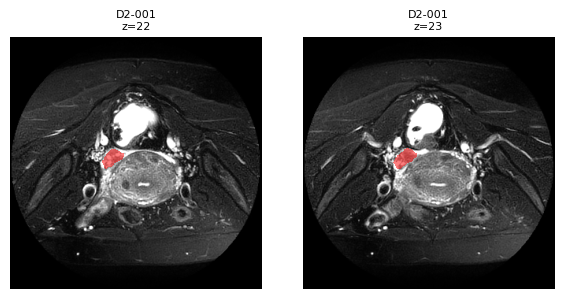

Patient D2-003


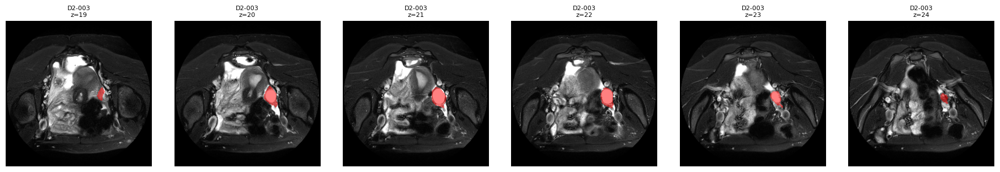

Patient D2-005


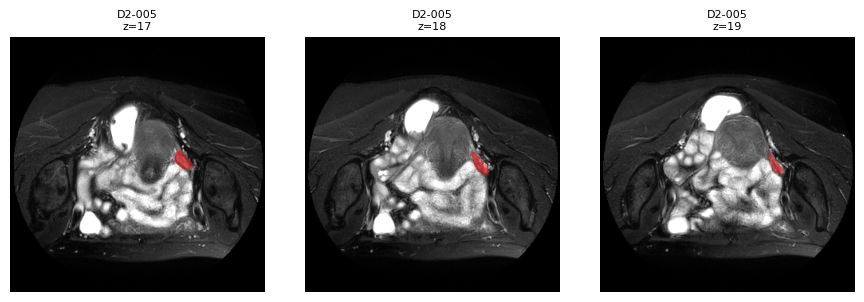

Patient D2-007


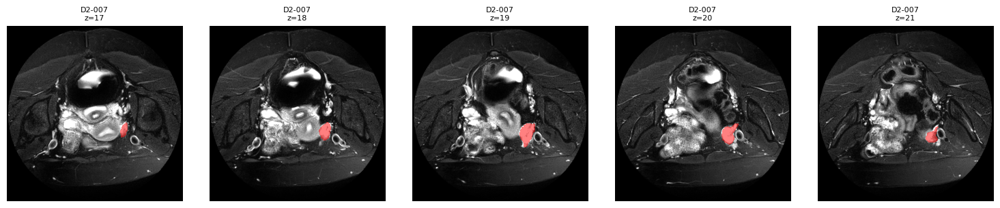

Patient D2-008


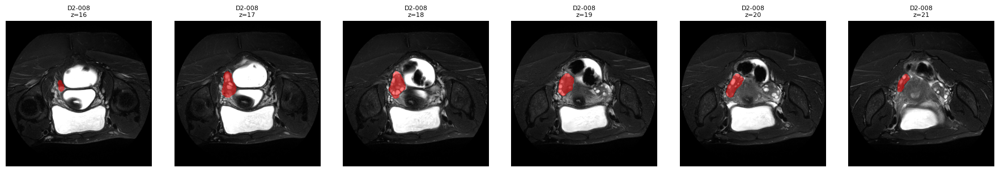

Patient D2-009


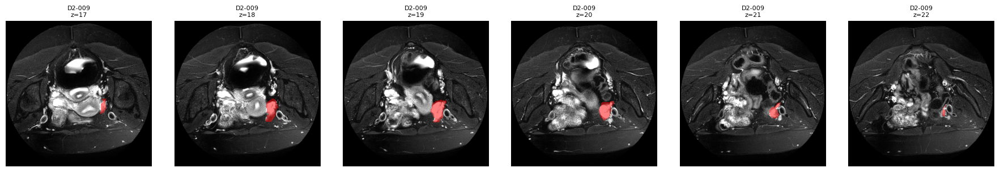

Patient D2-010


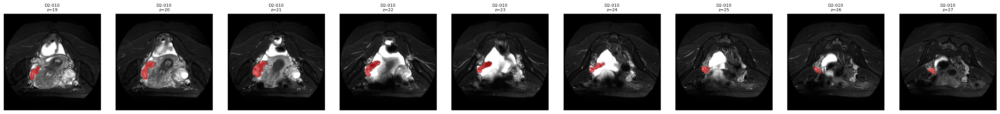

Patient D2-011


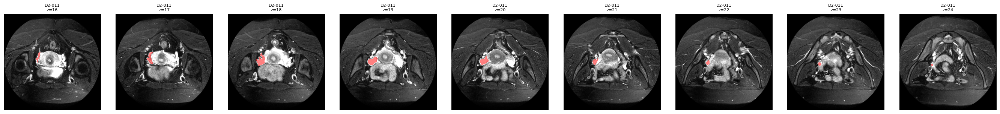

Patient D2-012


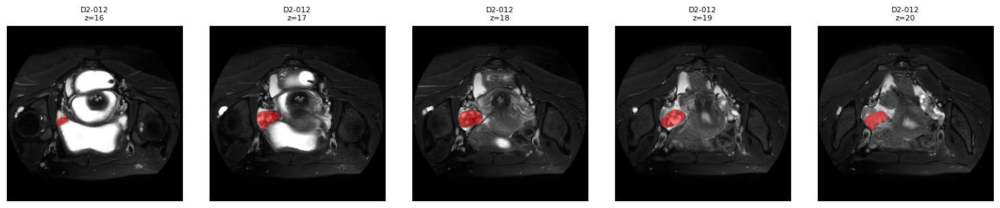

Patient D2-013


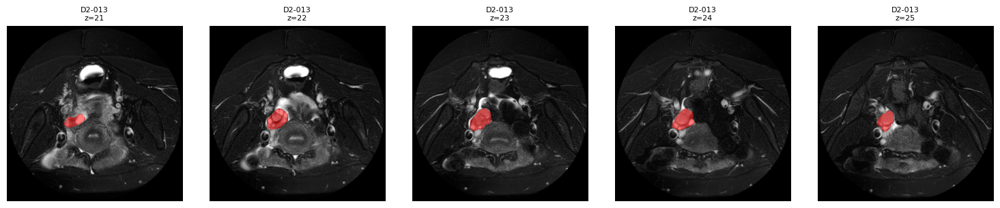

Patient D2-014


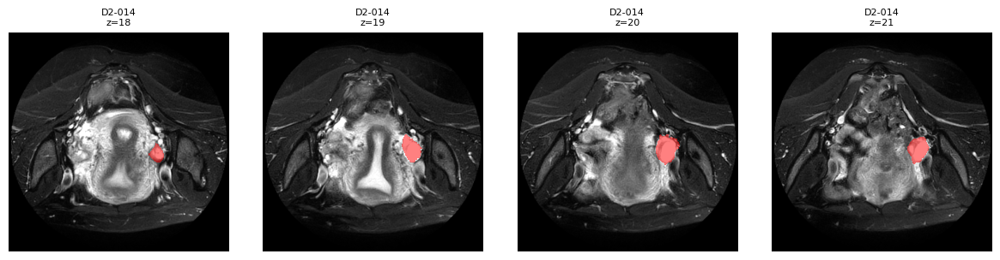

Patient D2-015


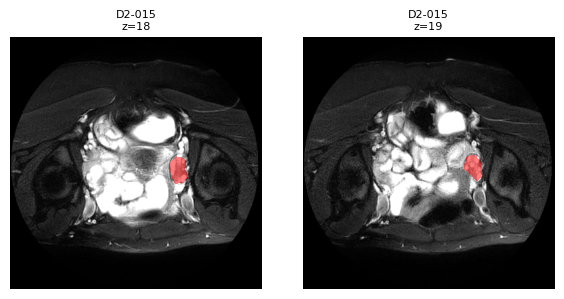

Patient D2-016


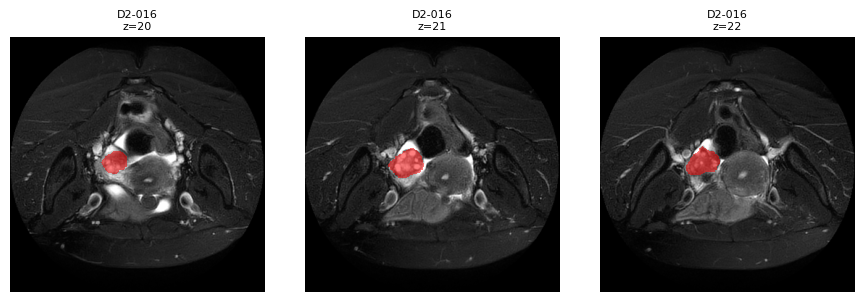

Patient D2-017


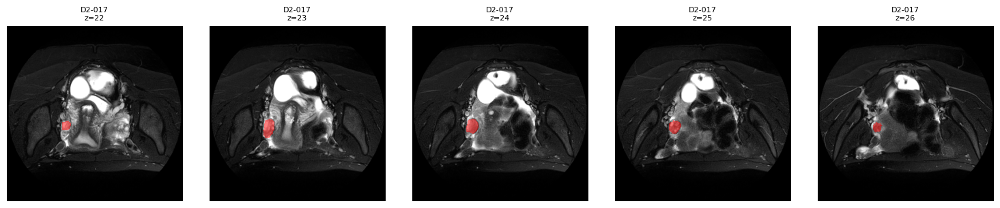

Patient D2-018


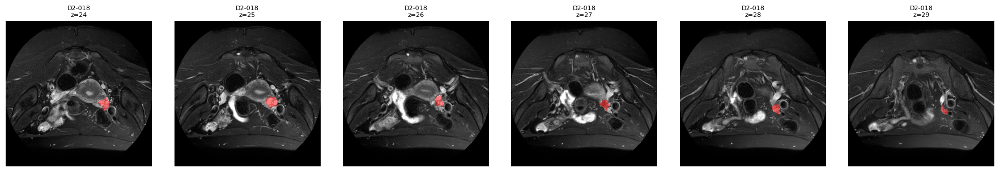

Patient D2-019


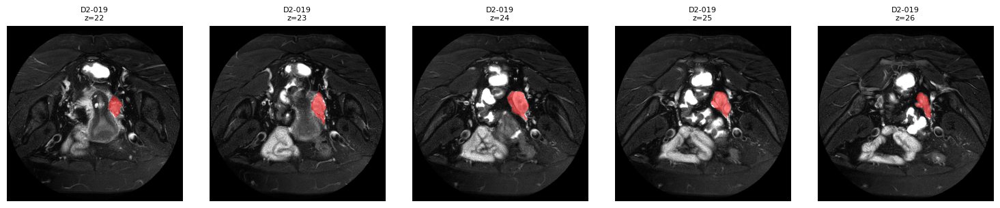

Patient D2-020


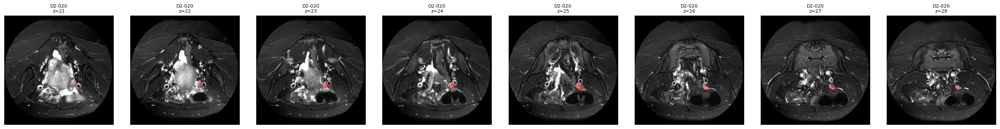

Patient D2-021


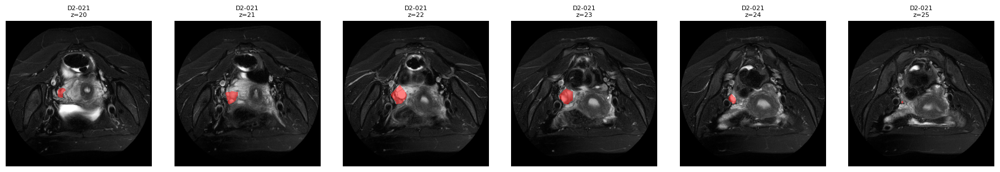

Patient D2-022


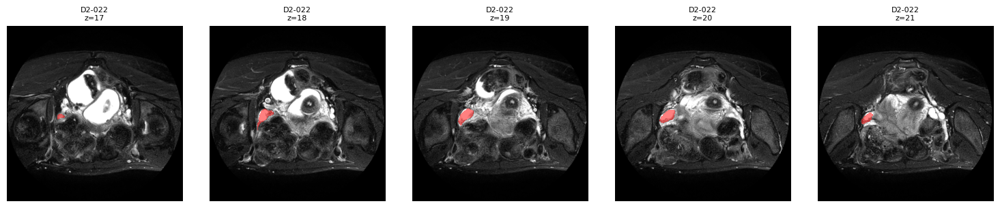

Patient D2-023


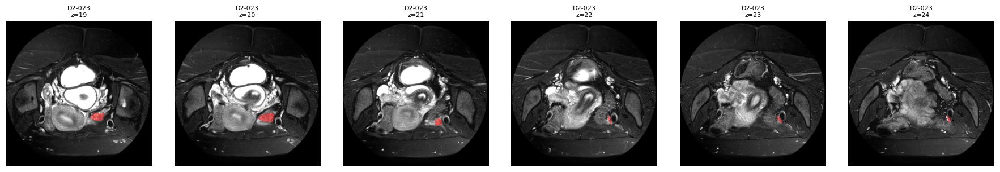

Patient D2-024


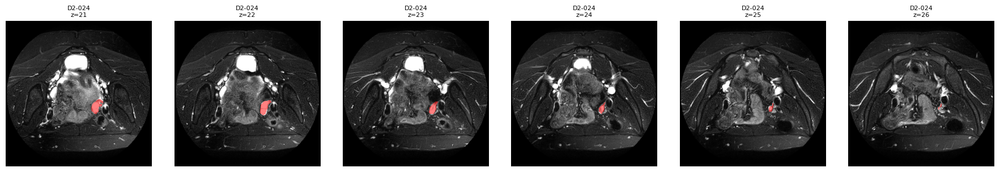

Patient D2-025


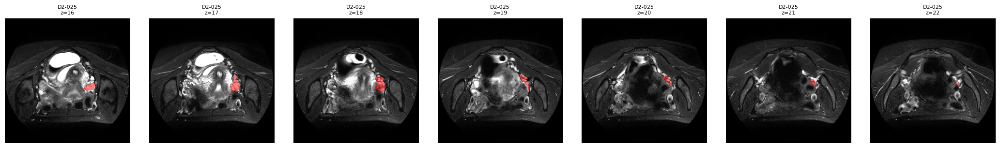

Patient D2-026


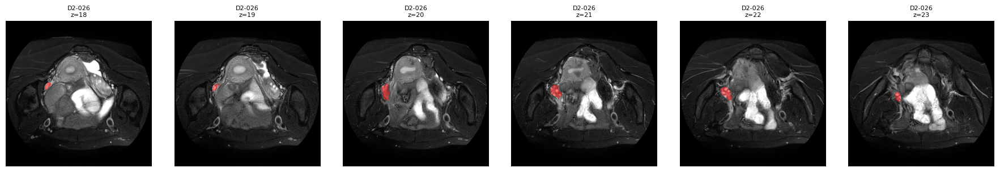

Patient D2-027


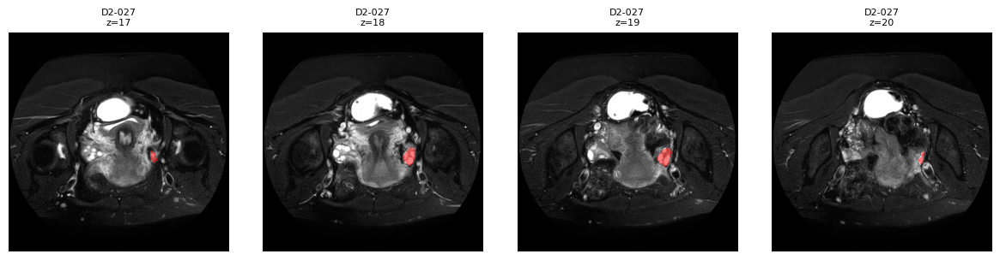

Patient D2-028


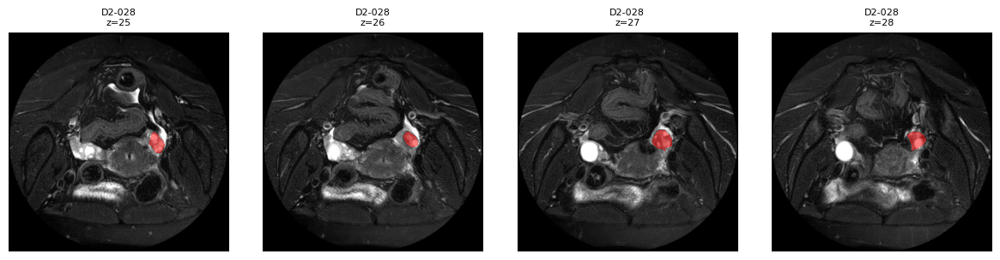

Patient D2-029


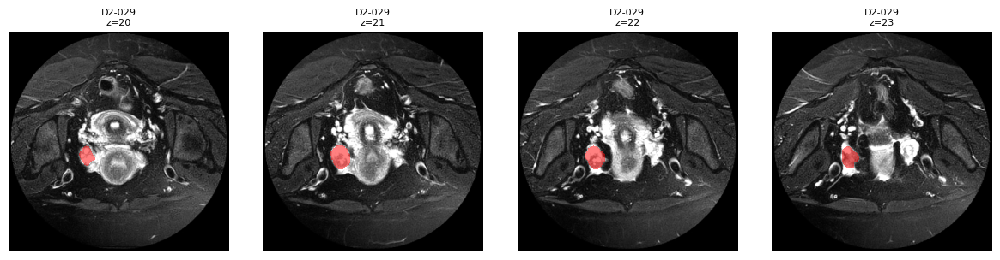

Patient D2-038


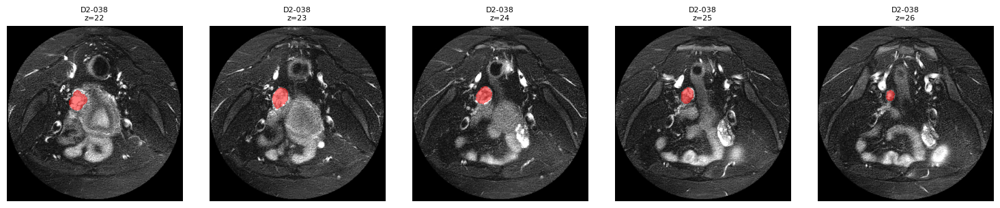

Patient D2-039


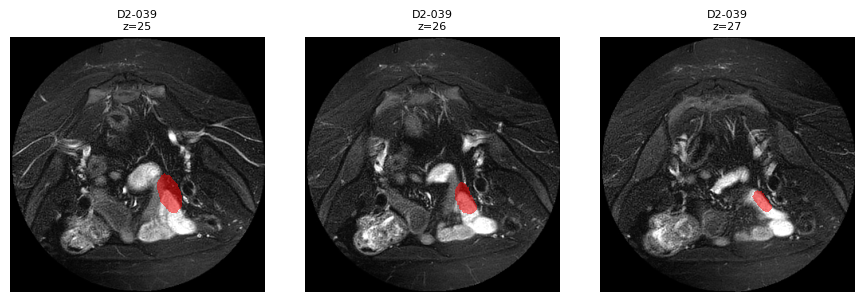

Patient D2-040


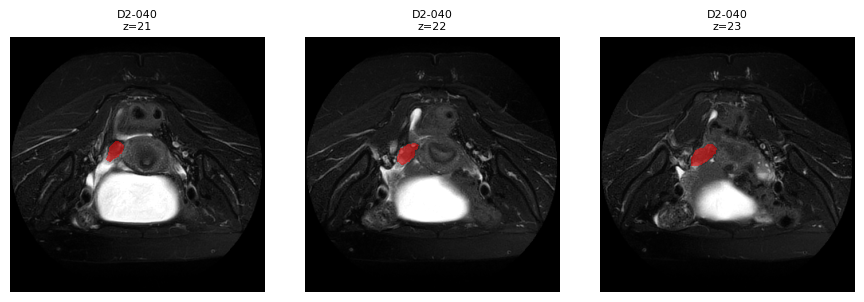

Patient D2-042


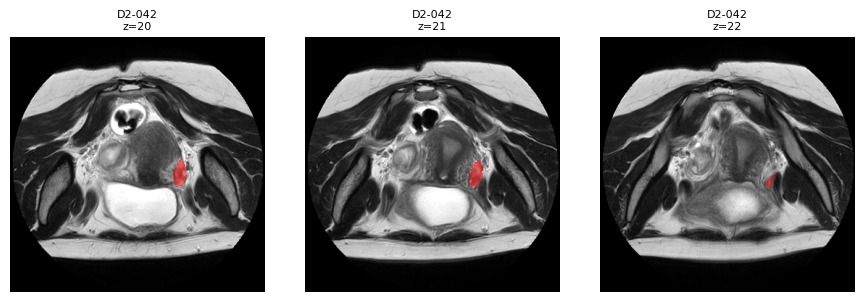

Patient D2-043


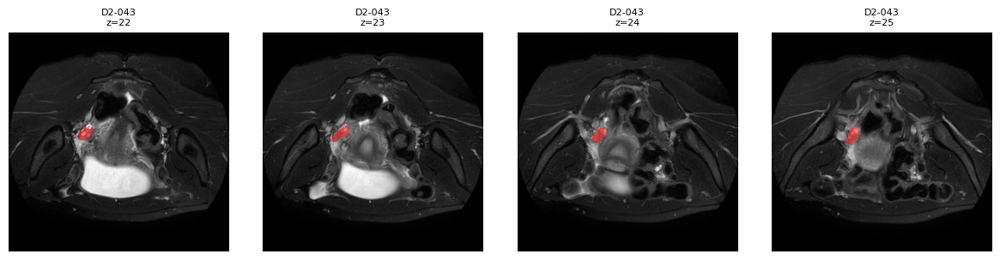

Patient D2-044


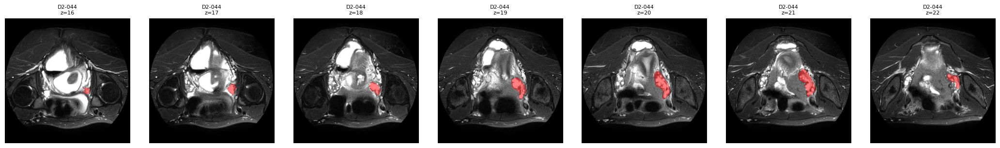

Patient D2-045


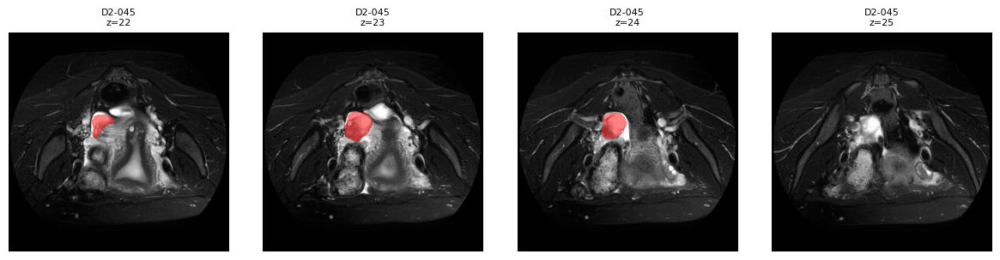

Patient D2-046


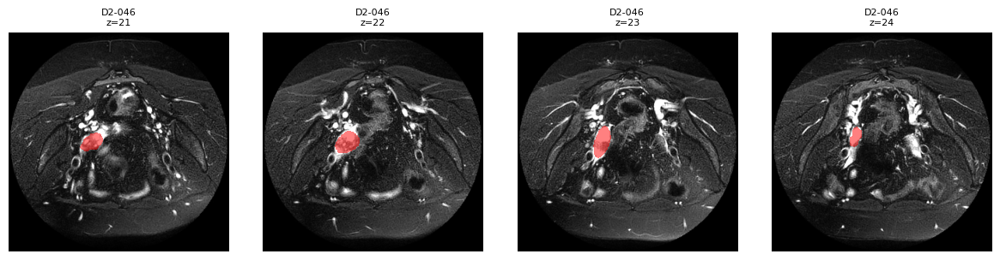

Patient D2-047


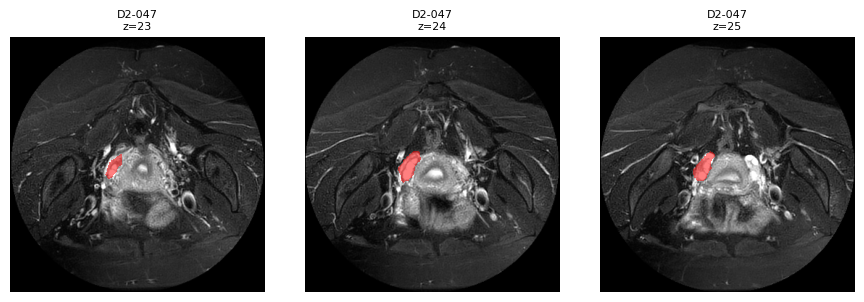

Patient D2-048


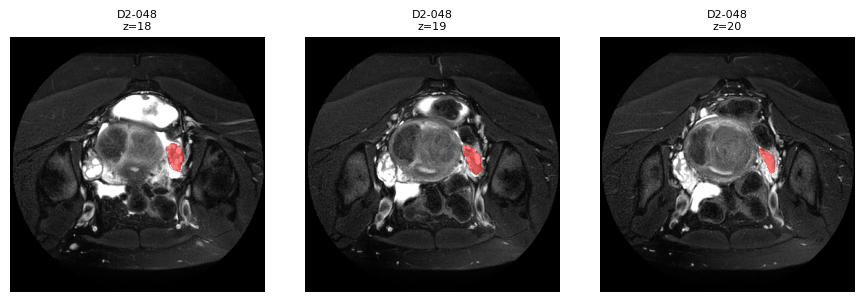

Patient D2-050


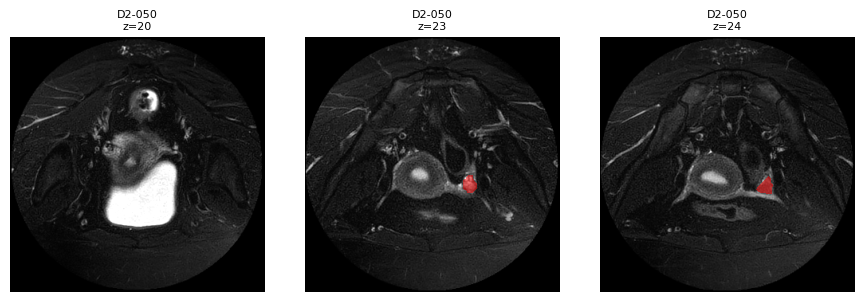

Patient D2-051


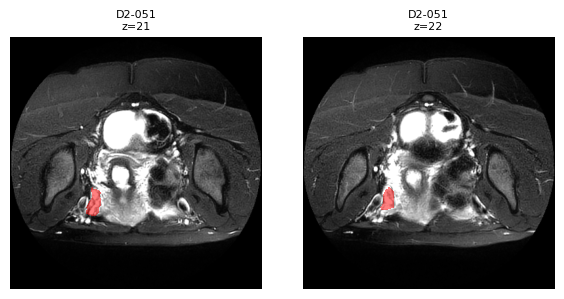

Patient D2-052


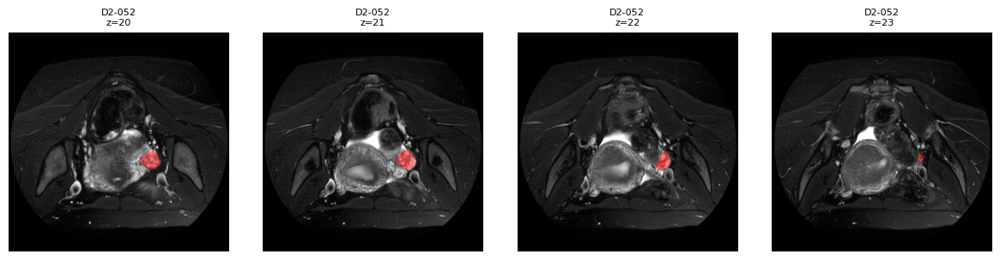

Patient D2-054


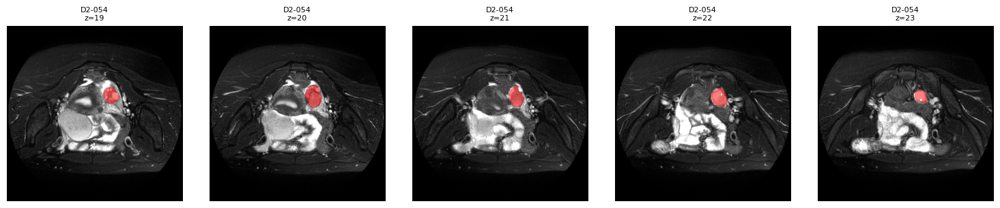

Patient D2-055


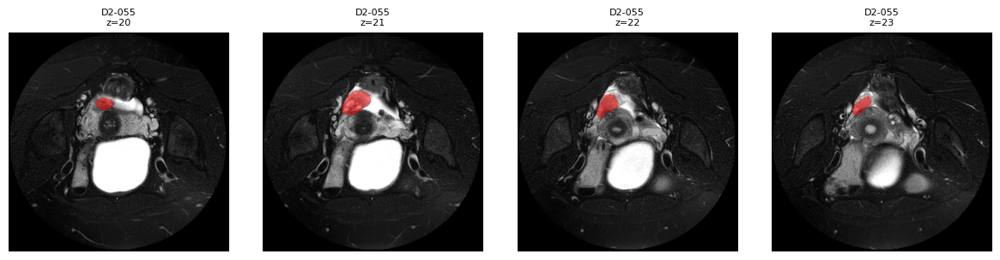

Patient D2-056


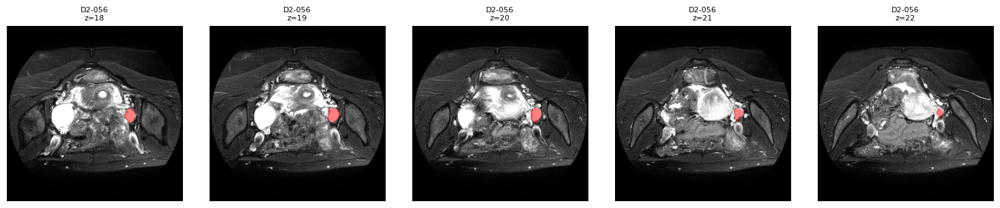

Patient D2-057


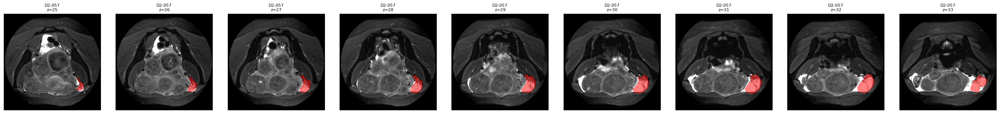

Patient D2-058


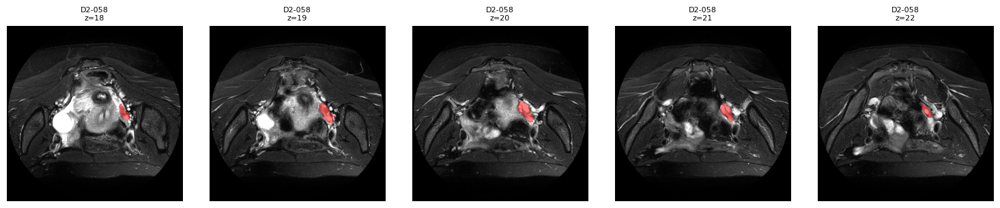

Patient D2-059


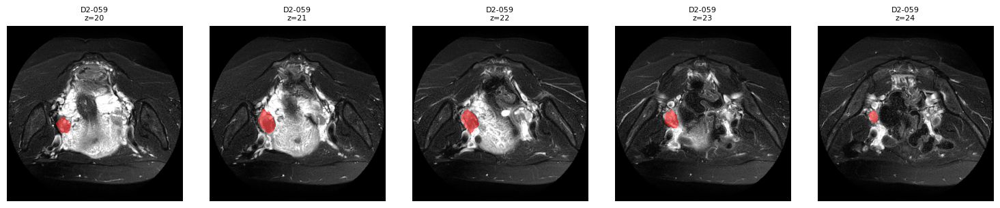

Patient D2-060


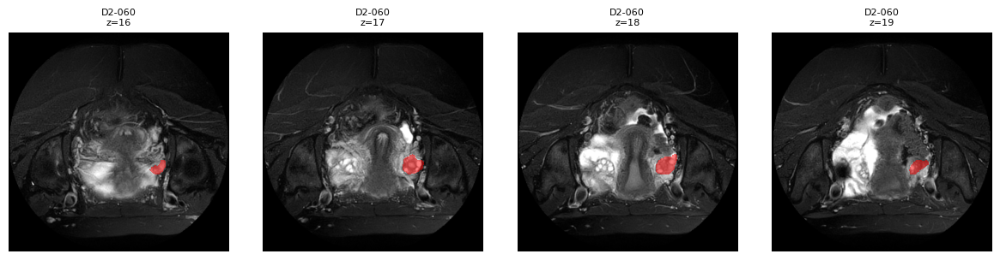

Patient D2-061


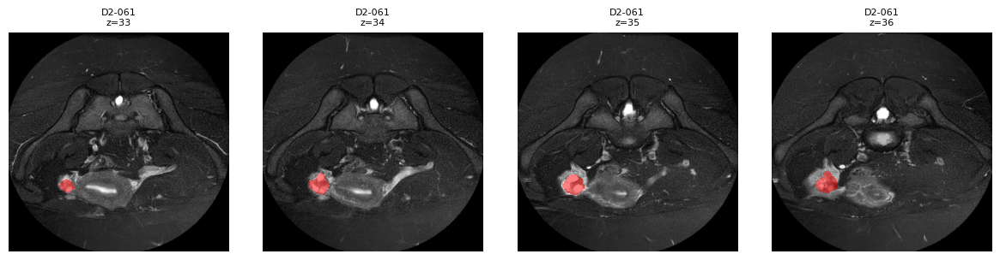

Patient D2-065


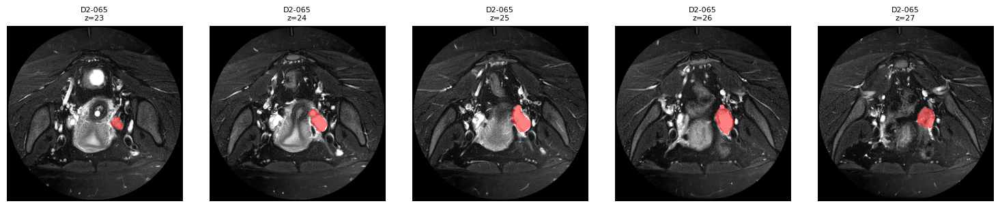

Patient D2-070


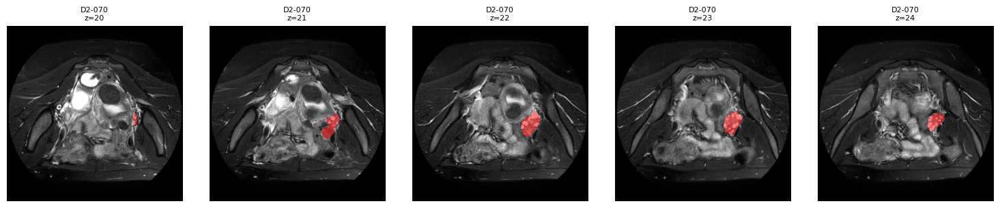

Patient D2-072


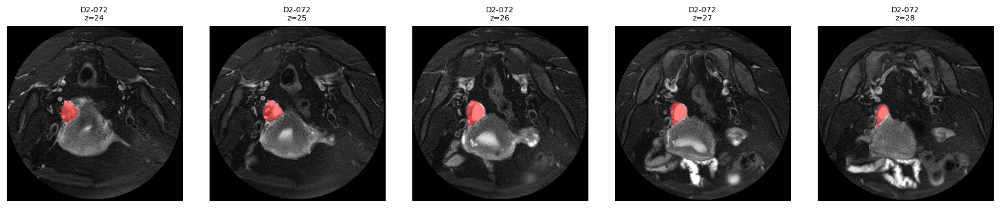

Patient D2-073


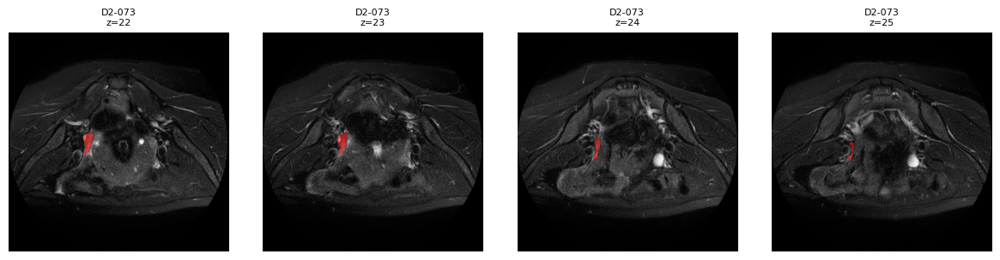

Patient D2-074


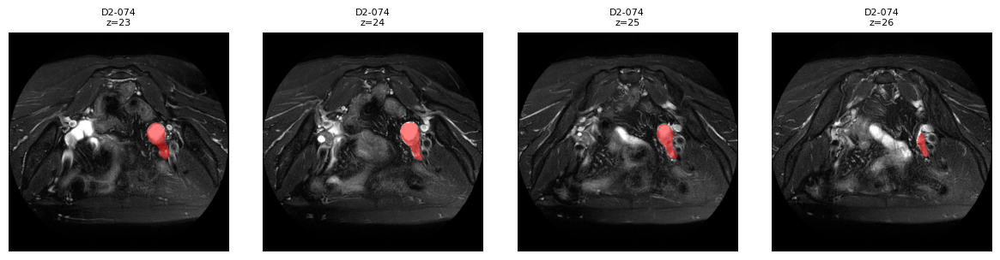

Patient D2-075


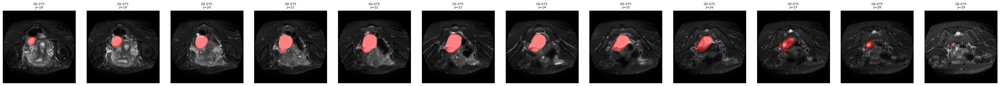

Patient D2-076


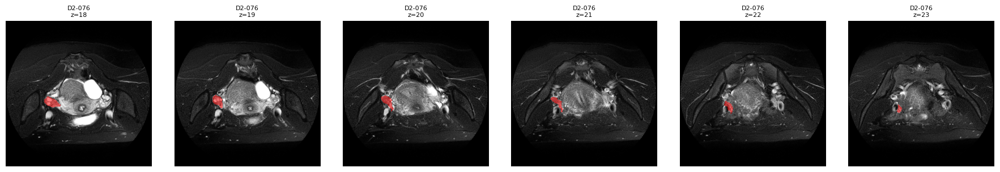

Patient D2-078


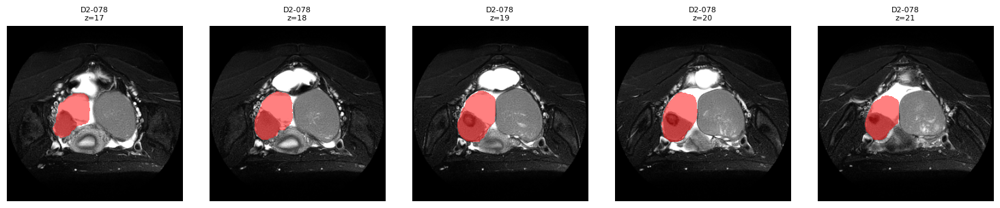

In [28]:
# %% [markdown]
# Plot all eligible patients: one row per patient, all slices with ov mask

# %%
for pid in manifest_df["patient_id"]:
    print(f"Patient {pid}")
    plot_patient_row(pid, manifest_df)


In [ ]:
# %% [markdown]
# ## Build final manifest for new experimental setup
# Exclude:
# - any patient whose folder contains *_em.nii.gz or *_cy.nii.gz
# - patients 039, 050, 075, 078


from pathlib import Path

# Start from the candidate manifest
final_df = manifest_df.copy()

def has_em_or_cy(row):
    """
    Return True if the patient's folder contains *_em.nii.gz or *_cy.nii.gz.
    """
    t2fs_path = Path(row["t2fs_path"])
    patient_dir = t2fs_path.parent  # e.g. .../D2_TCPW/D2-039

    has_em = any(patient_dir.glob("*_em.nii.gz"))
    has_cy = any(patient_dir.glob("*_cy.nii.gz"))

    return has_em or has_cy

# Flag patients with em/cy files
final_df["has_em_or_cy"] = final_df.apply(has_em_or_cy, axis=1)

print("Patients with *_em.nii.gz or *_cy.nii.gz present:")
display(final_df[final_df["has_em_or_cy"]][["patient_id", "t2fs_path"]])

# Exclude those patients
final_df = final_df[~final_df["has_em_or_cy"]].copy()

# Additionally exclude specific IDs
extra_exclude = {"D2-039", "D2-050", "D2-075", "D2-078"}

print("\nAdditionally excluding patients:", extra_exclude)
final_df = final_df[~final_df["patient_id"].isin(extra_exclude)].copy()

# Drop helper column
if "has_em_or_cy" in final_df.columns:
    final_df = final_df.drop(columns=["has_em_or_cy"])

final_df = final_df.sort_values("patient_id").reset_index(drop=True)

print("\nFinal manifest summary:")
print(f"  Original candidates: {len(manifest_df)}")
print(f"  Final included patients: {len(final_df)}")
display(final_df.head())

# Save final manifest
final_manifest_path = data_dir / "d2_manifest_t2fs_ov_final_new_experiment.csv"
final_df.to_csv(final_manifest_path, index=False)
print("\nSaved FINAL manifest to:", final_manifest_path)


Patients with *_em.nii.gz or *_cy.nii.gz present:


,patient_id,t2fs_path
0,D2-000,C:\Users\lytten\programming\dlvr-project\data\...
2,D2-003,C:\Users\lytten\programming\dlvr-project\data\...
5,D2-008,C:\Users\lytten\programming\dlvr-project\data\...
6,D2-009,C:\Users\lytten\programming\dlvr-project\data\...
8,D2-011,C:\Users\lytten\programming\dlvr-project\data\...
10,D2-013,C:\Users\lytten\programming\dlvr-project\data\...
28,D2-039,C:\Users\lytten\programming\dlvr-project\data\...
29,D2-040,C:\Users\lytten\programming\dlvr-project\data\...
30,D2-042,C:\Users\lytten\programming\dlvr-project\data\...
33,D2-045,C:\Users\lytten\programming\dlvr-project\data\...



Additionally excluding patients: {'D2-078', 'D2-050', 'D2-075', 'D2-039'}

Final manifest summary:
  Original candidates: 56
  Final included patients: 37


,patient_id,t2fs_path,ov_mask_path
0,D2-001,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...
1,D2-005,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...
2,D2-007,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...
3,D2-010,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...
4,D2-012,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...



Saved FINAL manifest to: C:\Users\lytten\programming\dlvr-project\data\d2_manifest_t2fs_ov_final_new_experiment.csv


In [30]:
# %% [markdown]
# ## Train/Val/Test split on the final manifest (patient-level)

# %%
import numpy as np

# final_df should be the 37-patient DataFrame we just saved
n_patients = len(final_df)
print("Total final patients:", n_patients)

# Desired counts
n_train = 26
n_val   = 6
n_test  = 5
assert n_train + n_val + n_test == n_patients, "Counts don't sum to total patients!"

# Reproducible shuffle
rng = np.random.default_rng(seed=42)

patient_ids = final_df["patient_id"].to_numpy()
rng.shuffle(patient_ids)

train_ids = patient_ids[:n_train]
val_ids   = patient_ids[n_train:n_train + n_val]
test_ids  = patient_ids[n_train + n_val:]

print("Train IDs:", train_ids)
print("Val IDs:",   val_ids)
print("Test IDs:",  test_ids)

# Assign split column
def assign_split(pid):
    if pid in train_ids:
        return "train"
    elif pid in val_ids:
        return "val"
    elif pid in test_ids:
        return "test"
    else:
        return "exclude"  # should not happen

final_df = final_df.copy()
final_df["split"] = final_df["patient_id"].apply(assign_split)

print("\nSplit counts:")
print(final_df["split"].value_counts())

display(final_df.head())


Total final patients: 37
Train IDs: ['D2-051' 'D2-027' 'D2-048' 'D2-014' 'D2-012' 'D2-044' 'D2-073' 'D2-016'
 'D2-047' 'D2-059' 'D2-019' 'D2-043' 'D2-029' 'D2-061' 'D2-025' 'D2-015'
 'D2-046' 'D2-055' 'D2-052' 'D2-018' 'D2-057' 'D2-028' 'D2-010' 'D2-001'
 'D2-024' 'D2-026']
Val IDs: ['D2-058' 'D2-021' 'D2-038' 'D2-020' 'D2-023' 'D2-065']
Test IDs: ['D2-007' 'D2-060' 'D2-005' 'D2-022' 'D2-017']

Split counts:
split
train    26
val       6
test      5
Name: count, dtype: int64


,patient_id,t2fs_path,ov_mask_path,split
0,D2-051,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train
1,D2-027,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train
2,D2-048,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train
3,D2-014,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train
4,D2-012,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train


In [31]:
# %%
final_split_manifest_path = data_dir / "d2_manifest_t2fs_ov_final_with_split.csv"
final_df.to_csv(final_split_manifest_path, index=False)
print("Saved final manifest with splits to:", final_split_manifest_path)


Saved final manifest with splits to: C:\Users\lytten\programming\dlvr-project\data\d2_manifest_t2fs_ov_final_with_split.csv


In [32]:
from pathlib import Path
import pandas as pd

project_root = Path("..").resolve()
data_dir = project_root / "data"

final_manifest_path = data_dir / "d2_manifest_t2fs_ov_final_with_split.csv"
final_df = pd.read_csv(final_manifest_path)

print("Final manifest loaded from:", final_manifest_path)
print("Columns:", final_df.columns.tolist())
print("Number of patients:", len(final_df))
final_df.head()


Final manifest loaded from: C:\Users\lytten\programming\dlvr-project\data\d2_manifest_t2fs_ov_final_with_split.csv
Columns: ['patient_id', 't2fs_path', 'ov_mask_path', 'split']
Number of patients: 37


,patient_id,t2fs_path,ov_mask_path,split
0,D2-051,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train
1,D2-027,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train
2,D2-048,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train
3,D2-014,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train
4,D2-012,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train


In [33]:
from pathlib import Path
import numpy as np
import nibabel as nib

project_root = Path("..").resolve()
data_dir = project_root / "data"

# Original and masked roots
d2_root = project_root / "data" / "UT-EndoMRI" / "D2_TCPW"
d2_masked_root = project_root / "data" / "UT-EndoMRI" / "D2_TCPW_masked"

print("Original D2 root:", d2_root)
print("Masked   D2 root:", d2_masked_root)

d2_masked_root.mkdir(parents=True, exist_ok=True)


Original D2 root: C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW
Masked   D2 root: C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked


In [34]:
def create_masked_t2fs_for_patient(row, overwrite=False):
    """
    Given a row from final_df with columns:
      - patient_id
      - t2fs_path
      - ov_mask_path
    create an ovary-side masked T2FS volume and save it under D2_TCPW_masked.

    Returns
    -------
    str : path to the masked T2FS file (relative to project root).
    """
    pid = row["patient_id"]

    # Resolve paths (handle relative/absolute robustly)
    t2fs_path = Path(row["t2fs_path"])
    ov_path   = Path(row["ov_mask_path"])

    # If stored as relative paths, make them relative to project_root
    if not t2fs_path.is_absolute():
        t2fs_path = project_root / t2fs_path
    if not ov_path.is_absolute():
        ov_path = project_root / ov_path

    assert t2fs_path.exists(), f"T2FS not found for {pid}: {t2fs_path}"
    assert ov_path.exists(),   f"Ovary mask not found for {pid}: {ov_path}"

    # Load volumes
    img_nii = nib.load(str(t2fs_path))
    msk_nii = nib.load(str(ov_path))

    img = img_nii.get_fdata()
    msk = msk_nii.get_fdata()

    if img.shape != msk.shape:
        raise ValueError(
            f"Shape mismatch for {pid}: img {img.shape}, mask {msk.shape}"
        )

    H, W, Z = img.shape

    # Find all mask voxels
    coords = np.where(msk > 0)
    if len(coords[0]) == 0:
        # Shouldn't happen after our filtering, but let's be safe.
        raise ValueError(f"No ovary mask voxels found for {pid}.")

    ys, xs, zs = coords
    cx = xs.mean()

    # Decide which side is ovary side based on centroid
    if cx <= W / 2.0:
        ovary_side = "left"
    else:
        ovary_side = "right"

    # Create masked copy
    img_masked = img.copy()

    if ovary_side == "left":
        # Keep left half, zero out right half
        img_masked[:, W // 2 :, :] = 0
    else:
        # Keep right half, zero out left half
        img_masked[:, : W // 2, :] = 0

    # Prepare output path
    patient_dir_masked = d2_masked_root / pid
    patient_dir_masked.mkdir(parents=True, exist_ok=True)

    masked_filename = f"{pid}_T2FS_masked.nii.gz"
    masked_path = patient_dir_masked / masked_filename

    if masked_path.exists() and not overwrite:
        print(f"{pid}: masked T2FS already exists, skipping write.")
    else:
        # Use original affine and header
        masked_nii = nib.Nifti1Image(img_masked, affine=img_nii.affine, header=img_nii.header)
        nib.save(masked_nii, str(masked_path))
        print(f"{pid}: saved masked T2FS to {masked_path}")

    # Return path relative to project_root so it's portable
    return str(masked_path.relative_to(project_root))


In [35]:
# Load final manifest (if not already in memory)
final_manifest_path = data_dir / "d2_manifest_t2fs_ov_final_with_split.csv"
final_df = pd.read_csv(final_manifest_path)

print("Loaded final manifest with split from:", final_manifest_path)
print("Columns:", final_df.columns.tolist())
print("Number of patients:", len(final_df))

# Create masked T2FS for each patient and store the new path
masked_paths = []

for _, row in final_df.iterrows():
    pid = row["patient_id"]
    print(f"Processing {pid}...")
    masked_rel_path = create_masked_t2fs_for_patient(row, overwrite=False)
    masked_paths.append(masked_rel_path)

final_df["t2fs_masked_path"] = masked_paths

final_df.head()


Loaded final manifest with split from: C:\Users\lytten\programming\dlvr-project\data\d2_manifest_t2fs_ov_final_with_split.csv
Columns: ['patient_id', 't2fs_path', 'ov_mask_path', 'split']
Number of patients: 37
Processing D2-051...
D2-051: saved masked T2FS to C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-051\D2-051_T2FS_masked.nii.gz
Processing D2-027...
D2-027: saved masked T2FS to C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-027\D2-027_T2FS_masked.nii.gz
Processing D2-048...
D2-048: saved masked T2FS to C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-048\D2-048_T2FS_masked.nii.gz
Processing D2-014...
D2-014: saved masked T2FS to C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-014\D2-014_T2FS_masked.nii.gz
Processing D2-012...
D2-012: saved masked T2FS to C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-012\D2-012_T2FS_masked.nii.gz
Processing D2-

,patient_id,t2fs_path,ov_mask_path,split,t2fs_masked_path
0,D2-051,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train,data\UT-EndoMRI\D2_TCPW_masked\D2-051\D2-051_T...
1,D2-027,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train,data\UT-EndoMRI\D2_TCPW_masked\D2-027\D2-027_T...
2,D2-048,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train,data\UT-EndoMRI\D2_TCPW_masked\D2-048\D2-048_T...
3,D2-014,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train,data\UT-EndoMRI\D2_TCPW_masked\D2-014\D2-014_T...
4,D2-012,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train,data\UT-EndoMRI\D2_TCPW_masked\D2-012\D2-012_T...


In [36]:
# %%
final_masked_manifest_path = data_dir / "d2_manifest_t2fs_ov_final_with_split_and_masked.csv"
final_df.to_csv(final_masked_manifest_path, index=False)
print("Saved final manifest with masked paths to:", final_masked_manifest_path)


Saved final manifest with masked paths to: C:\Users\lytten\programming\dlvr-project\data\d2_manifest_t2fs_ov_final_with_split_and_masked.csv


In [37]:
# %% [markdown]
# # Sanity check: show all masked images (one row per patient)
# Using: d2_manifest_t2fs_ov_final_with_split_and_masked.csv

# %%
from pathlib import Path
import numpy as np
import pandas as pd
import nibabel as nib
import matplotlib.pyplot as plt

plt.rcParams["figure.figsize"] = (6, 6)

project_root = Path("..").resolve()
data_dir = project_root / "data"

final_masked_manifest_path = data_dir / "d2_manifest_t2fs_ov_final_with_split_and_masked.csv"
final_df = pd.read_csv(final_masked_manifest_path)

print("Loaded masked manifest from:", final_masked_manifest_path)
print("Columns:", final_df.columns.tolist())
print("Number of patients:", len(final_df))
final_df.head()


Loaded masked manifest from: C:\Users\lytten\programming\dlvr-project\data\d2_manifest_t2fs_ov_final_with_split_and_masked.csv
Columns: ['patient_id', 't2fs_path', 'ov_mask_path', 'split', 't2fs_masked_path']
Number of patients: 37


,patient_id,t2fs_path,ov_mask_path,split,t2fs_masked_path
0,D2-051,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train,data\UT-EndoMRI\D2_TCPW_masked\D2-051\D2-051_T...
1,D2-027,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train,data\UT-EndoMRI\D2_TCPW_masked\D2-027\D2-027_T...
2,D2-048,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train,data\UT-EndoMRI\D2_TCPW_masked\D2-048\D2-048_T...
3,D2-014,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train,data\UT-EndoMRI\D2_TCPW_masked\D2-014\D2-014_T...
4,D2-012,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,train,data\UT-EndoMRI\D2_TCPW_masked\D2-012\D2-012_T...


In [38]:
# %% [markdown]
# Helper: load masked T2FS + ov mask for a patient

# %%
def load_masked_volumes(patient_id, manifest=final_df):
    """
    Load masked T2FS volume and ovary mask volume for a given patient_id,
    using t2fs_masked_path + ov_mask_path from the manifest.
    """
    row = manifest.loc[manifest["patient_id"] == patient_id]
    if row.empty:
        raise ValueError(f"Patient {patient_id} not found in manifest.")

    t2fs_masked_path = Path(row.iloc[0]["t2fs_masked_path"])
    ov_path          = Path(row.iloc[0]["ov_mask_path"])

    if not t2fs_masked_path.is_absolute():
        t2fs_masked_path = project_root / t2fs_masked_path
    if not ov_path.is_absolute():
        ov_path = project_root / ov_path

    assert t2fs_masked_path.exists(), f"Masked T2FS not found for {patient_id}: {t2fs_masked_path}"
    assert ov_path.exists(),          f"Ovary mask not found for {patient_id}: {ov_path}"

    img_nii = nib.load(str(t2fs_masked_path))
    msk_nii = nib.load(str(ov_path))

    img = img_nii.get_fdata()
    msk = msk_nii.get_fdata()

    if img.shape != msk.shape:
        print(
            f"WARNING: {patient_id} image/mask shape mismatch: "
            f"img {img.shape}, mask {msk.shape}"
        )

    return img, msk


In [ ]:
# %% [markdown]
# Plot masked T2FS + ov mask, only slices with mask > 0, one row per patient

# %%
def plot_masked_patient_row(patient_id, manifest=final_df, vmax_cols=None):
    """
    Plot all slices with non-zero ovary mask for a given patient in one row,
    using the *masked* T2FS image.

    Parameters
    ----------
    patient_id : str
        e.g. 'D2-001'
    manifest : pd.DataFrame
        Manifest with at least ['patient_id', 't2fs_masked_path', 'ov_mask_path', 'split'].
    vmax_cols : int or None
        If not None, cap the number of columns per row.
    """
    # Get split info
    row_meta = manifest.loc[manifest["patient_id"] == patient_id]
    if row_meta.empty:
        print(f"{patient_id}: not in manifest, skipping.")
        return
    split = row_meta.iloc[0]["split"]

    img, msk = load_masked_volumes(patient_id, manifest)

    img_slices = img.shape[2]
    msk_slices = msk.shape[2]

    if img_slices != msk_slices:
        print(
            f"WARNING: {patient_id} image/mask slice mismatch: "
            f"img={img_slices}, mask={msk_slices}. "
            "Using overlapping slices only."
        )

    n_slices = min(img_slices, msk_slices)

    # Find slices with any ovary mask
    mask_slice_indices = [k for k in range(n_slices) if np.any(msk[:, :, k] > 0)]

    if len(mask_slice_indices) == 0:
        print(f"{patient_id} ({split}): no slices with ovary mask > 0, skipping.")
        return

    if vmax_cols is not None:
        mask_slice_indices = mask_slice_indices[:vmax_cols]

    n_cols = len(mask_slice_indices)

    # Normalise image for display
    img_min, img_max = np.percentile(img, [1, 99])
    img_norm = np.clip((img - img_min) / (img_max - img_min + 1e-6), 0, 1)

    fig, axes = plt.subplots(
        1, n_cols, figsize=(3 * n_cols, 3),
        squeeze=False
    )
    axes = axes[0]

    # Big title for the whole row: patient + split
    fig.suptitle(f"{patient_id} – split: {split}", fontsize=12)

    for ax, k in zip(axes, mask_slice_indices):
        slice_img = img_norm[:, :, k].T
        slice_msk = msk[:, :, k].T

        ax.imshow(slice_img, cmap="gray", origin="lower")
        if np.any(slice_msk > 0):
            ax.imshow(
                np.ma.masked_where(slice_msk <= 0, slice_msk),
                cmap="autumn",
                alpha=0.5,
                origin="lower"
            )
        ax.set_axis_off()
        ax.set_title(f"z={k}", fontsize=8)

    plt.tight_layout()
    # make sure suptitle doesn't overlap
    plt.subplots_adjust(top=0.8)
    plt.show()


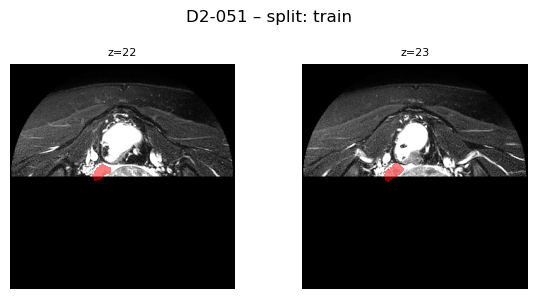

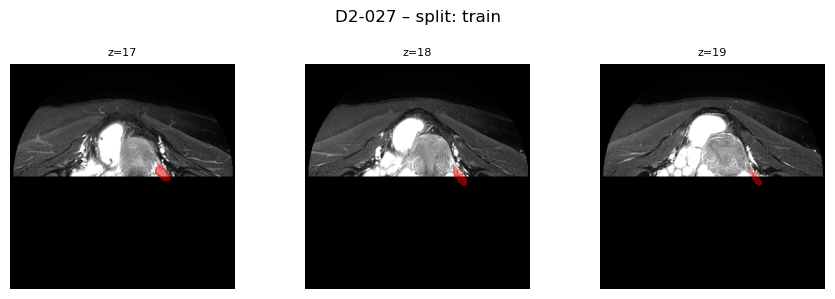

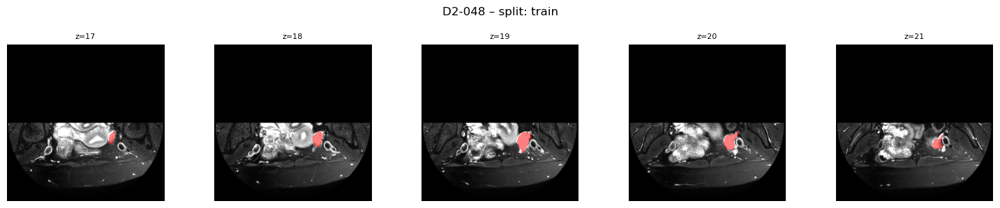

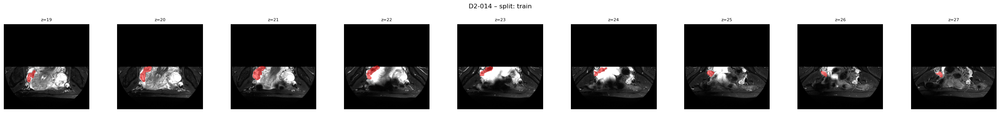

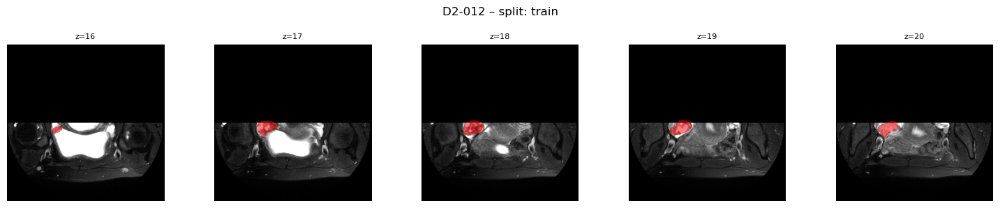

...

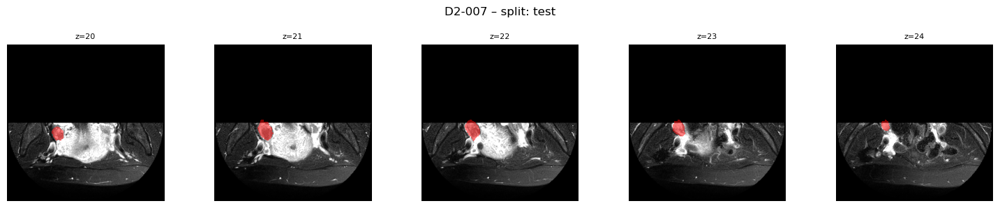

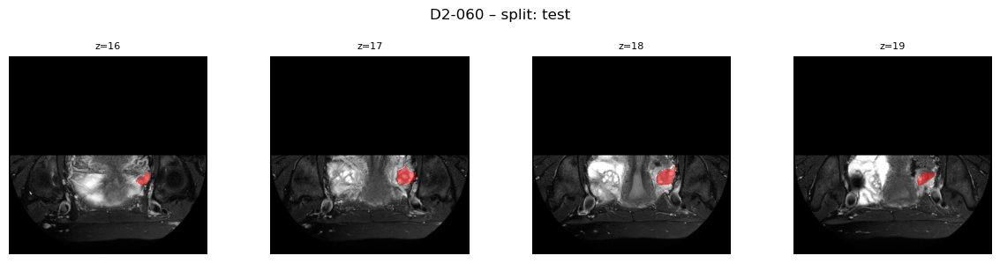

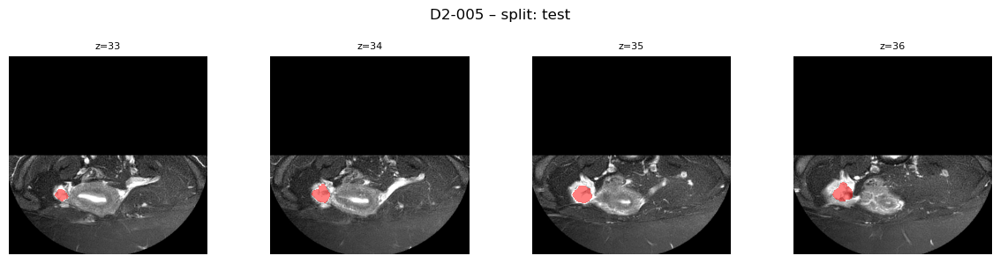

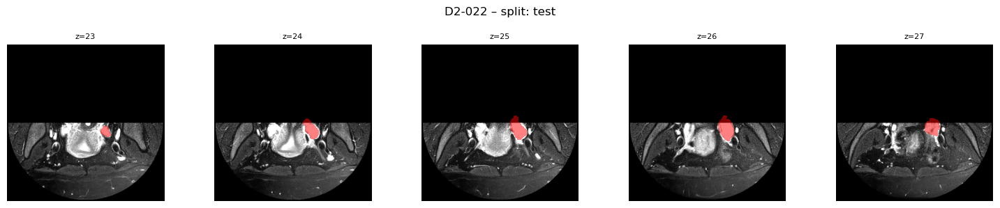

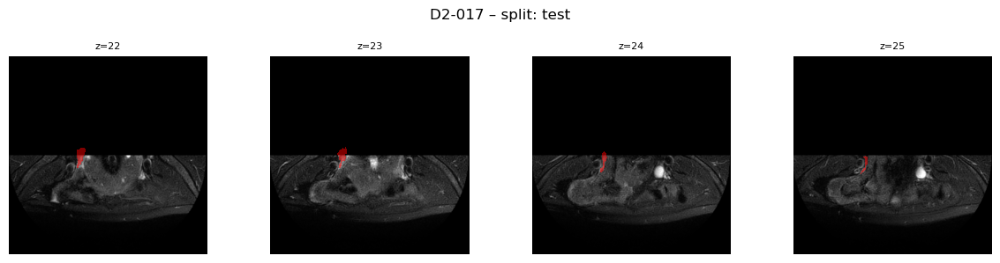

In [45]:
# %% [markdown]
# Show all patients: one row per patient, masked T2FS + ov mask slices

# %%
for pid in final_df["patient_id"]:
    plot_masked_patient_row(pid, final_df)


In [41]:
pid = "D2-027"

img_masked, msk = load_masked_volumes(pid, final_df)

z = 18  # pick a slice index where you know there is mask
sl = img_masked[:, :, z]  # NO transpose

H, W = sl.shape

left_sum  = sl[:, : W//2].sum()
right_sum = sl[:, W//2 :].sum()

print(f"Slice {z} shape: {sl.shape}")
print(f"Left  half sum:  {left_sum:.2f}")
print(f"Right half sum:  {right_sum:.2f}")


Slice 18 shape: (320, 320)
Left  half sum:  0.00
Right half sum:  11564226.07


In [46]:
from pathlib import Path
import numpy as np
import nibabel as nib

project_root = Path("..").resolve()
data_dir = project_root / "data"
d2_root = project_root / "data" / "UT-EndoMRI" / "D2_TCPW"
d2_masked_root = project_root / "data" / "UT-EndoMRI" / "D2_TCPW_masked"


def create_masked_t2fs_for_patient_vertical(row, overwrite=True):
    """
    Re-create ovary-side masked T2FS with a VERTICAL split in the way you view slices.

    We assume that in your viewer you use something like:
        slice_display = img[:, :, z].T
        plt.imshow(slice_display, ...)

    In that case:
      - The horizontal (left-right) direction on screen corresponds to the
        FIRST axis of the original volume (axis 0, 'y' index).
      - So we compute the ovary centroid along axis 0 (ys) and zero out the
        opposite half along axis 0, so the split appears vertical in your viewer.

    Parameters
    ----------
    row : pandas Series
        Row from final_df with 'patient_id', 't2fs_path', 'ov_mask_path'.
    overwrite : bool
        If True, overwrite existing masked NIfTI files.

    Returns
    -------
    str
        Path to the masked T2FS file, relative to project_root.
    """
    pid = row["patient_id"]

    # Resolve original paths
    t2fs_path = Path(row["t2fs_path"])
    ov_path = Path(row["ov_mask_path"])

    if not t2fs_path.is_absolute():
        t2fs_path = project_root / t2fs_path
    if not ov_path.is_absolute():
        ov_path = project_root / ov_path

    assert t2fs_path.exists(), f"T2FS not found for {pid}: {t2fs_path}"
    assert ov_path.exists(), f"Ovary mask not found for {pid}: {ov_path}"

    # Load volumes
    img_nii = nib.load(str(t2fs_path))
    msk_nii = nib.load(str(ov_path))

    img = img_nii.get_fdata()
    msk = msk_nii.get_fdata()

    if img.shape != msk.shape:
        raise ValueError(f"Shape mismatch for {pid}: img {img.shape}, mask {msk.shape}")

    H, W, Z = img.shape  # img[y, x, z]

    # Find all ovary voxels
    ys, xs, zs = np.where(msk > 0)
    if len(ys) == 0:
        raise ValueError(f"No ovary voxels found for {pid}.")

    # IMPORTANT:
    # We want left/right in YOUR viewer (which transposes),
    # and that horizontal viewer axis corresponds to original axis 0 (y).
    cy = ys.mean()

    # Create masked copy
    img_masked = img.copy()

    if cy <= H / 2.0:
        # Ovary is in "upper" half of the original array,
        # which corresponds to one side (say left) in your viewer.
        # Keep that half, zero out the other half along axis 0.
        img_masked[int(H // 2) : :, :,] = 0  # zero lower half
    else:
        # Ovary is in "lower" half -> keep that, zero out upper half
        img_masked[: int(H // 2), :, :] = 0  # zero upper half

    # Prepare output path
    patient_dir_masked = d2_masked_root / pid
    patient_dir_masked.mkdir(parents=True, exist_ok=True)

    masked_filename = f"{pid}_T2FS_masked.nii.gz"
    masked_path = patient_dir_masked / masked_filename

    if masked_path.exists() and not overwrite:
        print(f"{pid}: masked T2FS already exists and overwrite=False, skipping.")
    else:
        masked_nii = nib.Nifti1Image(img_masked, affine=img_nii.affine, header=img_nii.header)
        nib.save(masked_nii, str(masked_path))
        print(f"{pid}: saved VERTICAL masked T2FS to {masked_path}")

    return str(masked_path.relative_to(project_root))


In [47]:
import pandas as pd

final_manifest_path = data_dir / "d2_manifest_t2fs_ov_final_with_split_and_masked.csv"
final_df = pd.read_csv(final_manifest_path)

print("Loaded manifest:", final_manifest_path)
print("Num patients:", len(final_df))

new_masked_paths = []

for _, row in final_df.iterrows():
    pid = row["patient_id"]
    print(f"Remasking {pid}...")
    new_rel_path = create_masked_t2fs_for_patient_vertical(row, overwrite=True)
    new_masked_paths.append(new_rel_path)

# Keep manifest structure identical (paths unchanged or updated consistently)
final_df["t2fs_masked_path"] = new_masked_paths

# Save back to the SAME manifest (or a new one, up to you)
final_masked_manifest_path = data_dir / "d2_manifest_t2fs_ov_final_with_split_and_masked.csv"
final_df.to_csv(final_masked_manifest_path, index=False)
print("Updated manifest saved to:", final_masked_manifest_path)


Loaded manifest: C:\Users\lytten\programming\dlvr-project\data\d2_manifest_t2fs_ov_final_with_split_and_masked.csv
Num patients: 37
Remasking D2-051...
D2-051: saved VERTICAL masked T2FS to C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-051\D2-051_T2FS_masked.nii.gz
Remasking D2-027...
D2-027: saved VERTICAL masked T2FS to C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-027\D2-027_T2FS_masked.nii.gz
Remasking D2-048...
D2-048: saved VERTICAL masked T2FS to C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-048\D2-048_T2FS_masked.nii.gz
Remasking D2-014...
D2-014: saved VERTICAL masked T2FS to C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-014\D2-014_T2FS_masked.nii.gz
Remasking D2-012...
D2-012: saved VERTICAL masked T2FS to C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-012\D2-012_T2FS_masked.nii.gz
Remasking D2-044...
D2-044: saved VERTICAL masked T2F

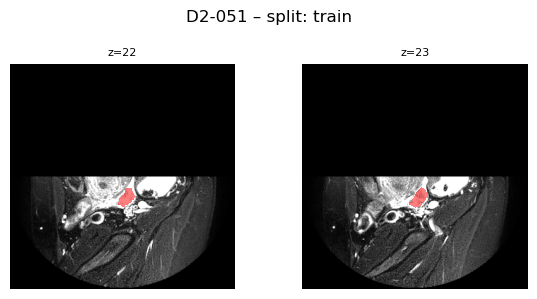

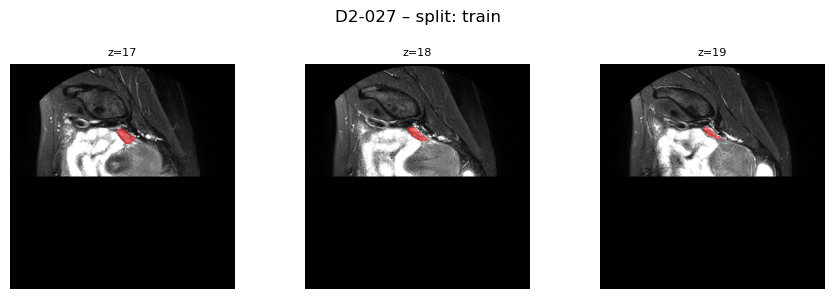

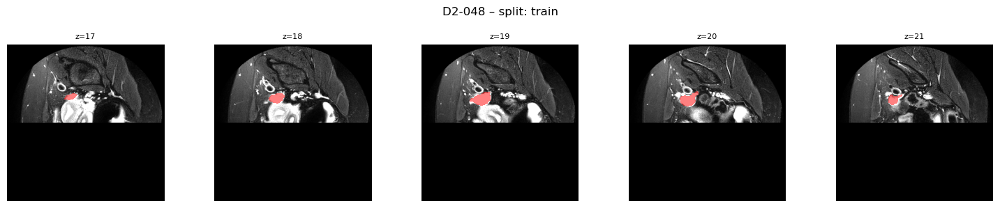

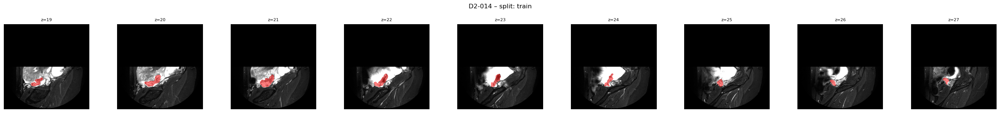

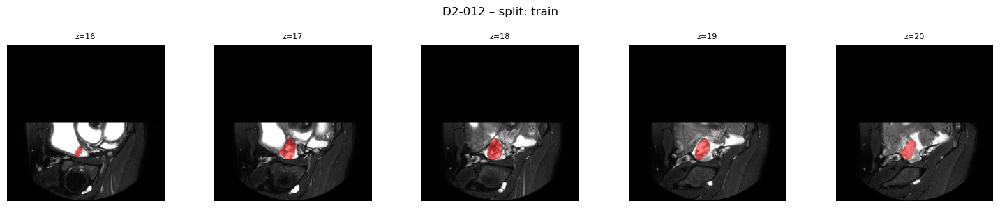

...

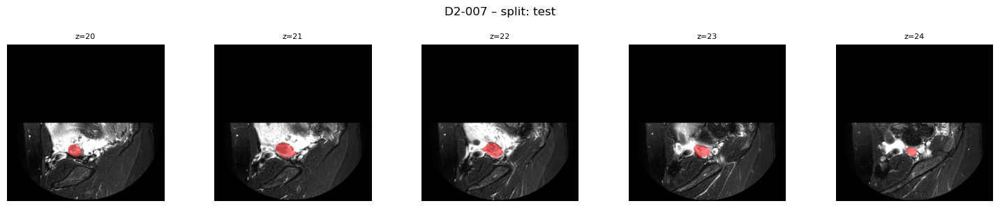

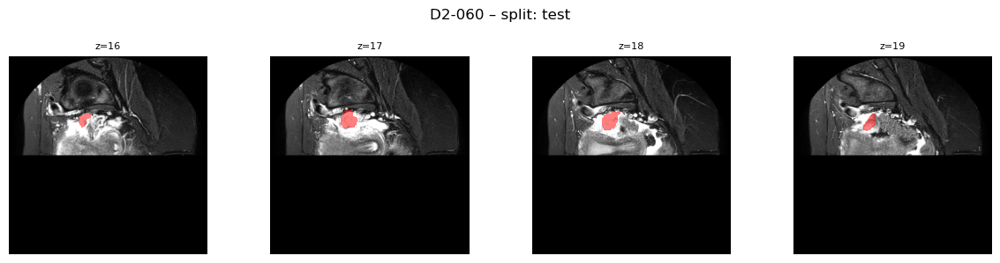

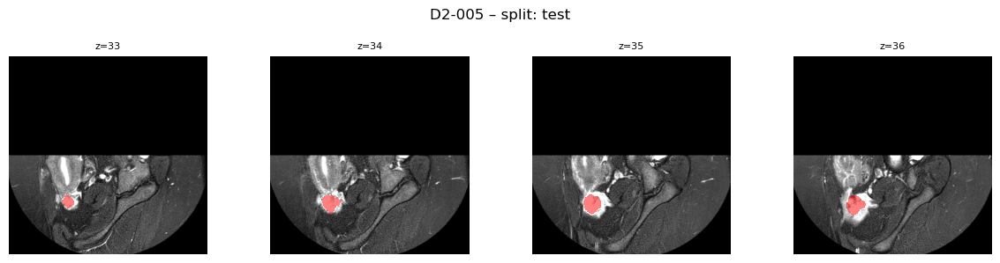

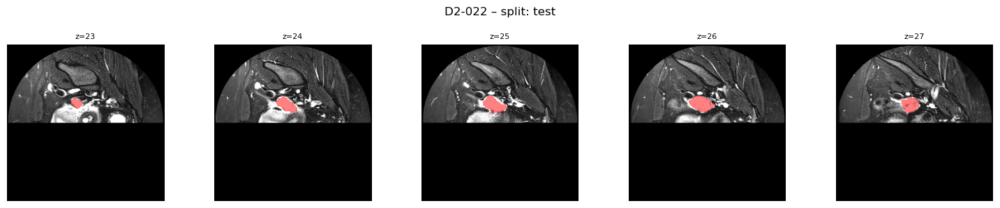

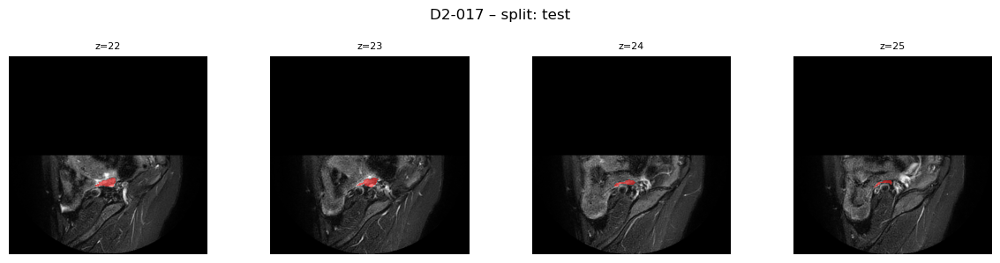

In [49]:
for pid in final_df["patient_id"]:
    plot_masked_patient_row(pid, final_df)


In [50]:
# %% [markdown]
# RAovSeg-style preprocessing for a single 2D slice

# %%
import numpy as np
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt

def raovseg_preprocess_slice(img_np):
    """
    RAovSeg-style preprocessing as implemented in src/data_loader.py:

    1. Percentile clipping [1, 99].
    2. Min-max normalization to [0, 1].
    3. Intensity mapping:
       - invert high intensities (> 0.5),
       - set values in [o1, o2) to 1.
    """
    o1, o2 = 0.22, 0.3

    # 1. Percentile clipping
    p1, p99 = np.percentile(img_np, 1), np.percentile(img_np, 99)
    img_clipped = np.clip(img_np, p1, p99)

    # 2. Min-max normalization
    min_val, max_val = img_clipped.min(), img_clipped.max()
    img_norm = (img_clipped - min_val) / (max_val - min_val) if max_val > min_val else img_clipped

    # 3. Intensity mapping (same logic as _preprocess_raovseg in data_loader.py)
    mask_between = (img_norm >= o1) & (img_norm < o2)
    mask_gt_05 = img_norm > 0.5

    final_img = img_norm.copy()
    # Invert high intensities
    final_img[mask_gt_05] = 1.0 - img_norm[mask_gt_05]
    # Highlight ovary range
    final_img[mask_between] = 1.0

    return final_img


def resize_img_and_mask_to_256(img2d, mask2d, size=256):
    """
    Resize img and mask to (size, size) using the same logic
    as the dataset (bicubic for image, nearest for mask).
    """
    # img2d, mask2d: 2D numpy arrays
    img_t = torch.from_numpy(img2d).unsqueeze(0).unsqueeze(0).float()   # [1, 1, H, W]
    mask_t = torch.from_numpy(mask2d).unsqueeze(0).unsqueeze(0).float() # [1, 1, H, W]

    img_resized = F.interpolate(img_t, size=(size, size), mode="bicubic", align_corners=False)
    mask_resized = F.interpolate(mask_t, size=(size, size), mode="nearest")

    img_out = img_resized.squeeze().numpy()
    mask_out = mask_resized.squeeze().numpy()

    return img_out, mask_out


In [52]:
# %% [markdown]
# Show how the model sees masked images after RAovSeg preprocessing

# %%
import random

def show_model_view_samples(manifest=final_df, num_patients=3, seed=0):
    """
    For a few random train patients:
      - pick one random ovary-positive slice,
      - show raw masked image,
      - show RAovSeg-preprocessed + 256×256 resized image,
      - show preprocessed image with resized mask overlay.
    """
    rng = random.Random(seed)

    train_df = manifest[manifest["split"] == "train"].reset_index(drop=True)
    n_train = len(train_df)
    print(f"Train patients: {n_train}")

    chosen_indices = rng.sample(range(n_train), k=min(num_patients, n_train))

    for idx in chosen_indices:
        row = train_df.iloc[idx]
        pid = row["patient_id"]
        print(f"\nPatient {pid} (split: {row['split']})")

        # Load masked volume + mask
        img_vol, msk_vol = load_masked_volumes(pid, manifest)

        H, W, Z = img_vol.shape

        # Find ovary-positive slices
        mask_slice_indices = [k for k in range(Z) if np.any(msk_vol[:, :, k] > 0)]
        if not mask_slice_indices:
            print(f"  No ovary-positive slices for {pid}, skipping.")
            continue

        z = rng.choice(mask_slice_indices)
        print(f"  Using slice z={z}")

        raw_slice = img_vol[:, :, z]
        mask_slice = msk_vol[:, :, z]

        # RAovSeg preprocessing
        preproc_slice = raovseg_preprocess_slice(raw_slice)

        # Resize to 256×256 like the dataset
        preproc_resized, mask_resized = resize_img_and_mask_to_256(preproc_slice, mask_slice, size=256)

        # --- Plot ---
        fig, axes = plt.subplots(1, 3, figsize=(12, 4))

        # 1) Raw masked image
        axes[0].imshow(raw_slice, cmap="gray")
        axes[0].set_title("Raw masked T2FS slice")
        axes[0].axis("off")

        # 2) Preprocessed (RAovSeg), resized
        axes[1].imshow(preproc_resized, cmap="gray")
        axes[1].set_title("RAovSeg preprocessed\nresized 256×256")
        axes[1].axis("off")

        # 3) Preprocessed + mask overlay (model input + GT)
        axes[2].imshow(preproc_resized, cmap="gray")
        if np.any(mask_resized > 0):
            axes[2].imshow(
                np.ma.masked_where(mask_resized <= 0, mask_resized),
                cmap="autumn",
                alpha=0.5,
            )
        axes[2].set_title("Preprocessed + resized mask")
        axes[2].axis("off")

        fig.suptitle(f"{pid} – model view example (train)", fontsize=12)
        plt.tight_layout()
        plt.show()


Train patients: 26

Patient D2-057 (split: train)
  Using slice z=22


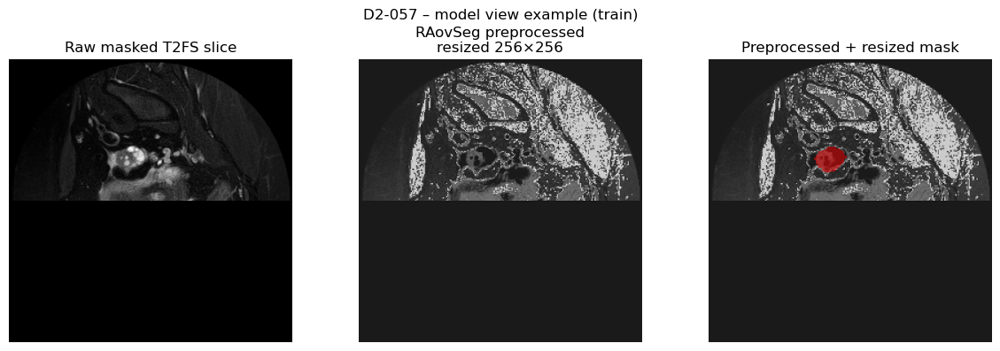


Patient D2-014 (split: train)
  Using slice z=22


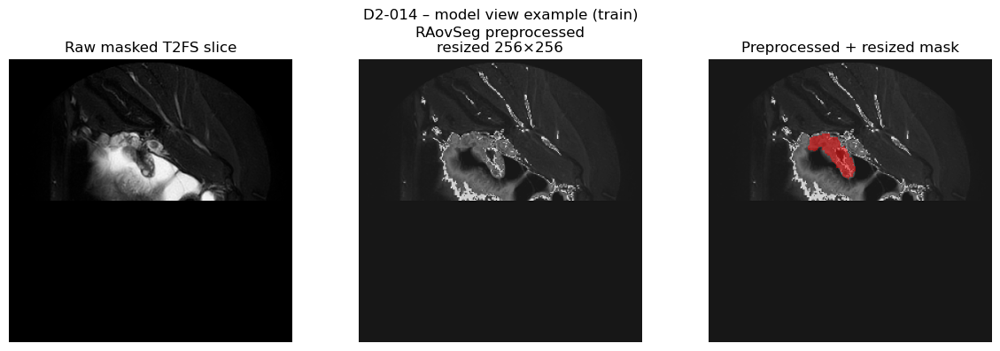


Patient D2-051 (split: train)
  Using slice z=22


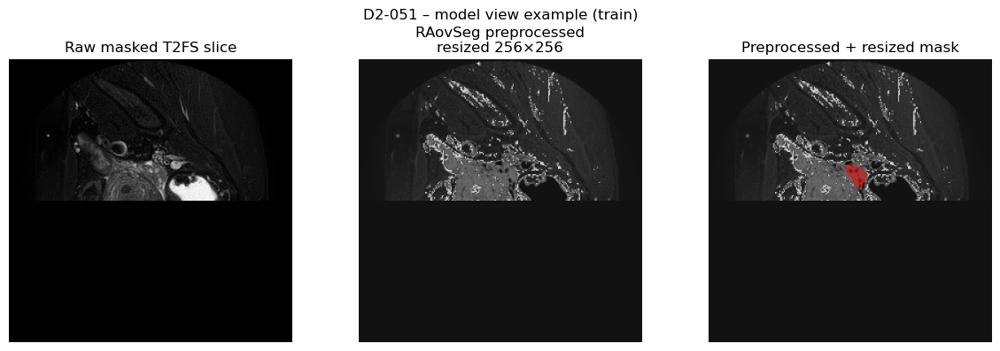

In [53]:
# %%
show_model_view_samples(final_df, num_patients=3, seed=42)


In [54]:
import numpy as np

def orient_for_report(img2d, mask2d=None, k=1):
    """
    Rotate image (and optional mask) by 90*k degrees counterclockwise
    for nicer, consistent report figures.
    """
    img_disp = np.rot90(img2d, k=k)
    if mask2d is None:
        return img_disp
    mask_disp = np.rot90(mask2d, k=k)
    return img_disp, mask_disp


In [55]:
import random
import matplotlib.pyplot as plt

def show_model_view_samples_for_report(manifest=final_df, num_patients=3, seed=0):
    """
    For a few random train patients:
      - pick one random ovary-positive slice,
      - show raw masked image (rotated for report),
      - show RAovSeg-preprocessed + 256×256 resized image (rotated),
      - show preprocessed image with resized mask overlay (rotated).
    """
    rng = random.Random(seed)

    train_df = manifest[manifest["split"] == "train"].reset_index(drop=True)
    n_train = len(train_df)
    print(f"Train patients: {n_train}")

    chosen_indices = rng.sample(range(n_train), k=min(num_patients, n_train))

    for idx in chosen_indices:
        row = train_df.iloc[idx]
        pid = row["patient_id"]
        print(f"\nPatient {pid} (split: {row['split']})")

        # Load masked volume + mask
        img_vol, msk_vol = load_masked_volumes(pid, manifest)

        H, W, Z = img_vol.shape

        # Ovary-positive slices
        mask_slice_indices = [k for k in range(Z) if np.any(msk_vol[:, :, k] > 0)]
        if not mask_slice_indices:
            print(f"  No ovary-positive slices for {pid}, skipping.")
            continue

        z = rng.choice(mask_slice_indices)
        print(f"  Using slice z={z}")

        raw_slice = img_vol[:, :, z]
        mask_slice = msk_vol[:, :, z]

        # RAovSeg preprocessing
        preproc_slice = raovseg_preprocess_slice(raw_slice)

        # Resize to 256×256 like the dataset
        preproc_resized, mask_resized = resize_img_and_mask_to_256(preproc_slice, mask_slice, size=256)

        # --- Rotate for report orientation ---
        raw_disp, _         = orient_for_report(raw_slice, mask_slice, k=1)
        preproc_disp, _     = orient_for_report(preproc_resized, mask_resized, k=1)
        preproc_mask_disp, mask_disp = orient_for_report(preproc_resized, mask_resized, k=1)

        # --- Plot ---
        fig, axes = plt.subplots(1, 3, figsize=(12, 4))

        # 1) Raw masked image (report orientation)
        axes[0].imshow(raw_disp, cmap="gray")
        axes[0].set_title("Raw masked T2FS slice\n(report orientation)")
        axes[0].axis("off")

        # 2) Preprocessed, resized (report orientation)
        axes[1].imshow(preproc_disp, cmap="gray")
        axes[1].set_title("RAovSeg preprocessed\nresized 256×256 (report)")
        axes[1].axis("off")

        # 3) Preprocessed + mask overlay (report orientation)
        axes[2].imshow(preproc_mask_disp, cmap="gray")
        if np.any(mask_disp > 0):
            axes[2].imshow(
                np.ma.masked_where(mask_disp <= 0, mask_disp),
                cmap="autumn",
                alpha=0.5,
            )
        axes[2].set_title("Preprocessed + resized mask\n(report orientation)")
        axes[2].axis("off")

        fig.suptitle(f"{pid} – model view example (train)", fontsize=12)
        plt.tight_layout()
        plt.show()


Train patients: 26

Patient D2-057 (split: train)
  Using slice z=22


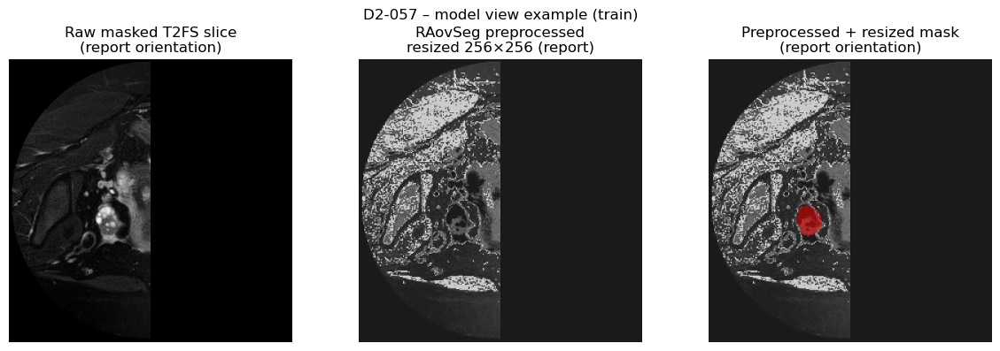


Patient D2-014 (split: train)
  Using slice z=22


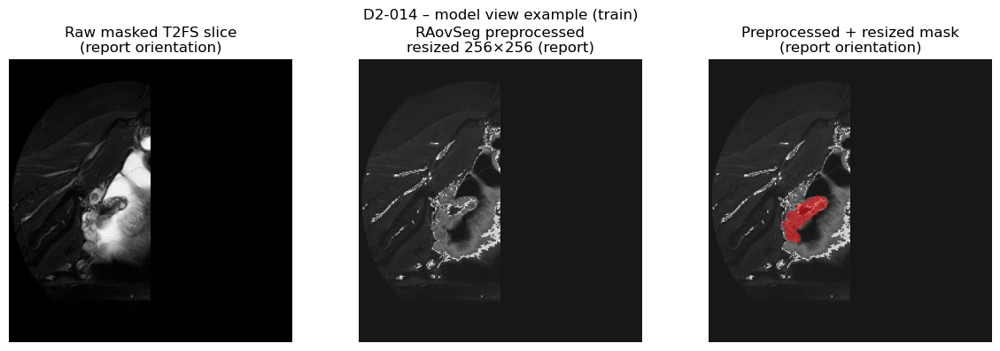


Patient D2-051 (split: train)
  Using slice z=22


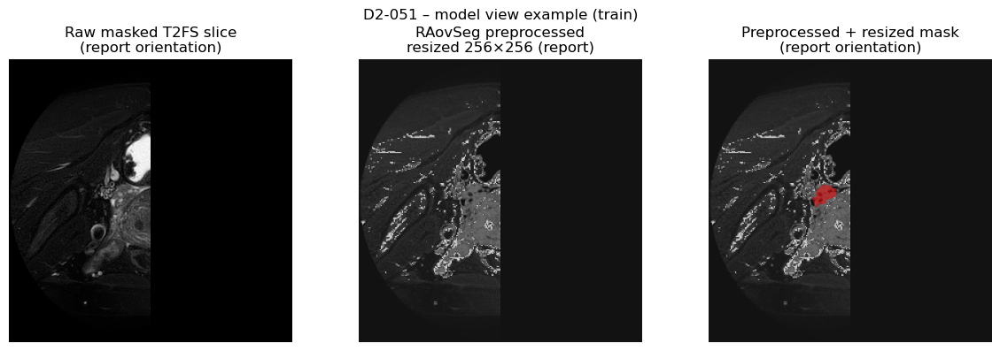

In [56]:
show_model_view_samples_for_report(final_df, num_patients=3, seed=42)


In [1]:
from pathlib import Path
import shutil

# Adjust if your notebook is not in dlvr-project/notebooks
project_root = Path("..").resolve()

d2_root = project_root / "data" / "UT-EndoMRI" / "D2_TCPW"
d2_masked_root = project_root / "data" / "UT-EndoMRI" / "D2_TCPW_masked"

print("Original D2 root:", d2_root)
print("Masked   D2 root:", d2_masked_root)

assert d2_root.is_dir(), f"Missing original D2 root: {d2_root}"
assert d2_masked_root.is_dir(), f"Missing masked D2 root: {d2_masked_root}"

copied = 0
skipped_missing_src = []
skipped_missing_dst = []

# Loop over patients that already exist in D2_TCPW_masked
for masked_patient_dir in sorted(d2_masked_root.iterdir()):
    if not masked_patient_dir.is_dir():
        continue

    pid = masked_patient_dir.name  # e.g. "D2-039"
    src_patient_dir = d2_root / pid

    if not src_patient_dir.is_dir():
        print(f"[WARN] No original folder for {pid}, skipping.")
        skipped_missing_dst.append(pid)
        continue

    src_ov = src_patient_dir / f"{pid}_ov.nii.gz"
    dst_ov = masked_patient_dir / f"{pid}_ov.nii.gz"

    if not src_ov.exists():
        print(f"[WARN] No ov mask found for {pid} at {src_ov}, skipping.")
        skipped_missing_src.append(pid)
        continue

    shutil.copy2(src_ov, dst_ov)
    copied += 1
    print(f"Copied ov mask for {pid} → {dst_ov}")

print(f"\nDone. Copied ov masks for {copied} patients.")
if skipped_missing_src:
    print("Patients missing ov mask in original D2:", skipped_missing_src)
if skipped_missing_dst:
    print("Patients missing original folder for masked entry:", skipped_missing_dst)


Original D2 root: C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW
Masked   D2 root: C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked
Copied ov mask for D2-001 → C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-001\D2-001_ov.nii.gz
Copied ov mask for D2-005 → C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-005\D2-005_ov.nii.gz
Copied ov mask for D2-007 → C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-007\D2-007_ov.nii.gz
Copied ov mask for D2-010 → C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-010\D2-010_ov.nii.gz
Copied ov mask for D2-012 → C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-012\D2-012_ov.nii.gz
Copied ov mask for D2-014 → C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked\D2-014\D2-014_ov.nii.gz
Copied ov mask for D2-015 → C:\Users\lytten\programming\dlvr-project\data\UT-EndoMR

Masked D2 root: C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW_masked
Found 37 masked patient folders.


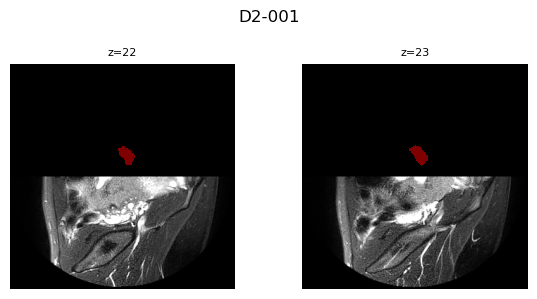

[WARN] D2-005: shape mismatch img (384, 384, 42) vs ov (320, 320, 34), using overlap.


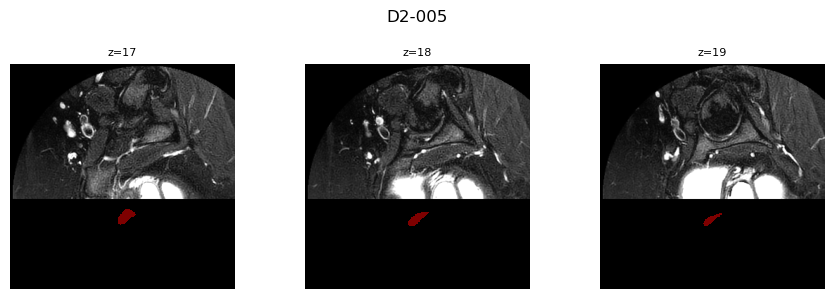

[WARN] D2-007: shape mismatch img (320, 320, 34) vs ov (352, 352, 34), using overlap.


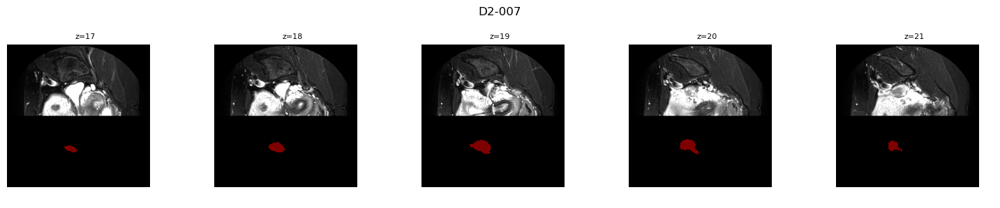

[WARN] D2-010: shape mismatch img (352, 352, 36) vs ov (352, 352, 34), using overlap.


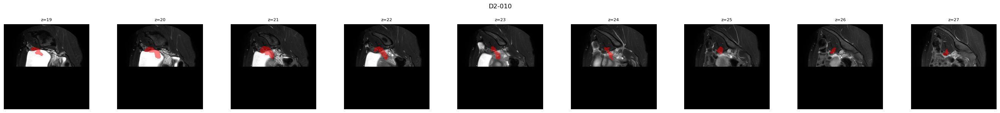

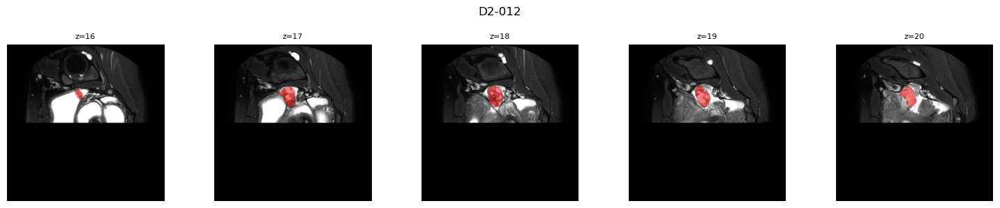

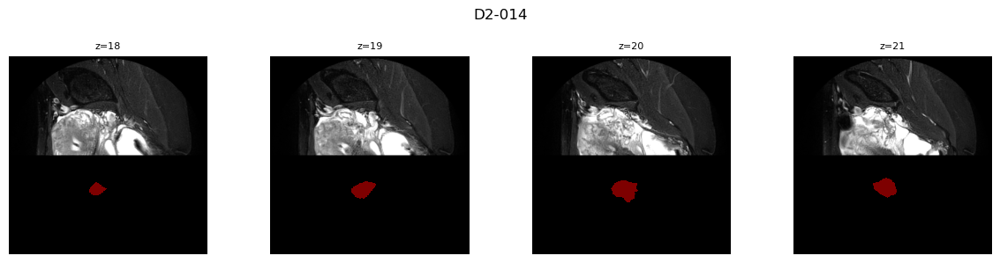

[WARN] D2-015: shape mismatch img (320, 320, 36) vs ov (384, 384, 38), using overlap.


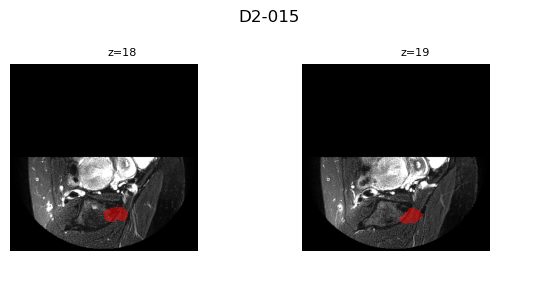

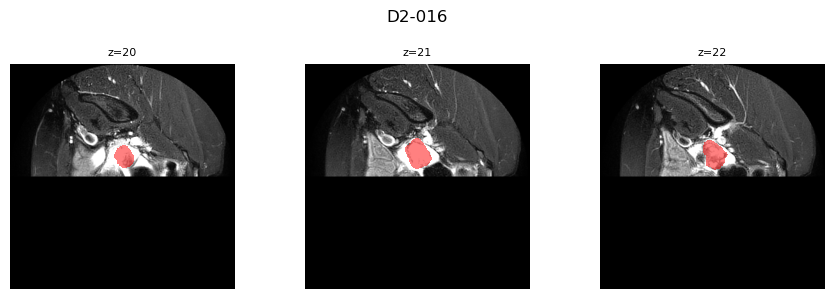

[WARN] D2-017: shape mismatch img (352, 352, 32) vs ov (384, 384, 40), using overlap.


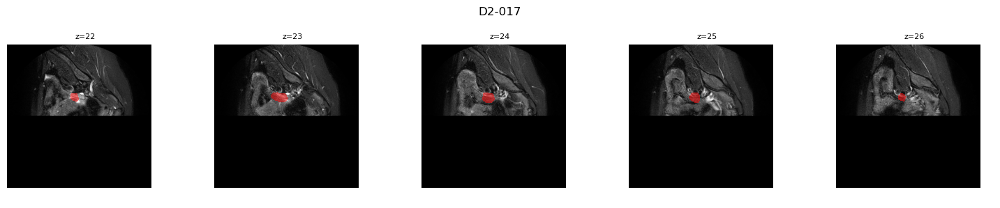

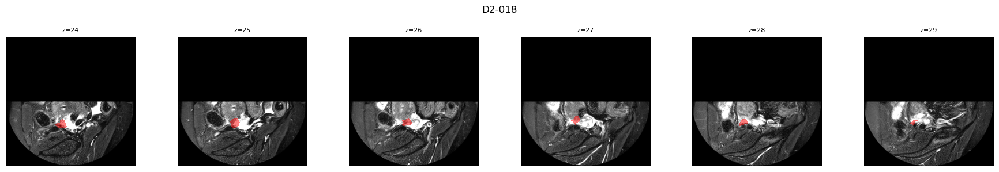

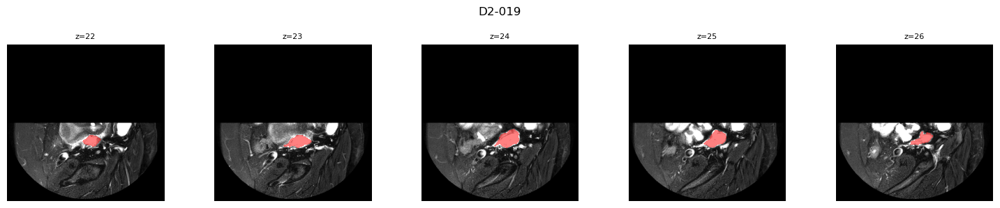

[WARN] D2-020: shape mismatch img (320, 320, 37) vs ov (320, 320, 34), using overlap.


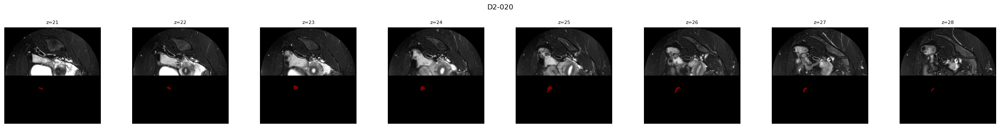

[WARN] D2-021: shape mismatch img (384, 384, 38) vs ov (352, 352, 36), using overlap.


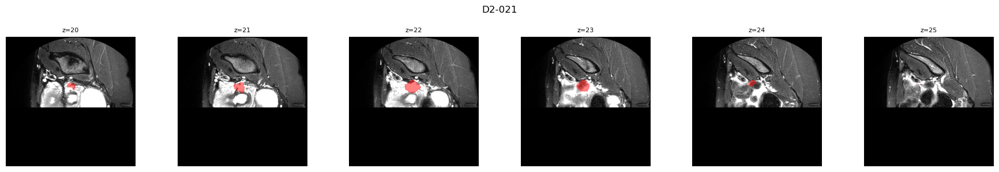

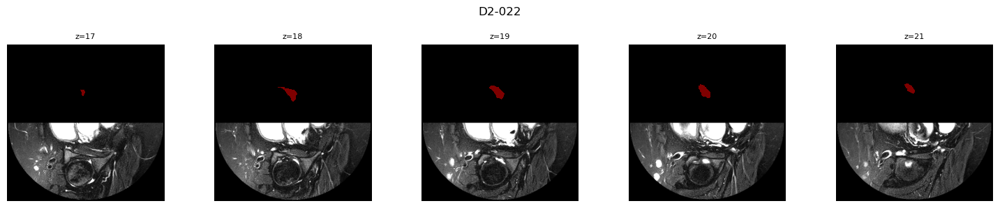

[WARN] D2-023: shape mismatch img (384, 384, 44) vs ov (384, 384, 39), using overlap.


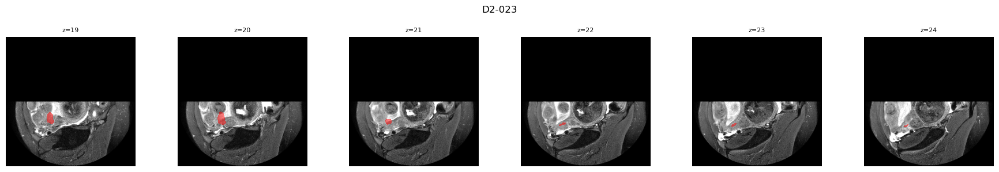

[WARN] D2-024: shape mismatch img (320, 320, 34) vs ov (320, 320, 36), using overlap.


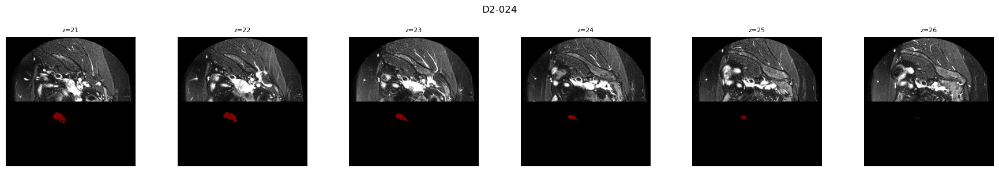

[WARN] D2-025: shape mismatch img (384, 384, 39) vs ov (352, 352, 34), using overlap.


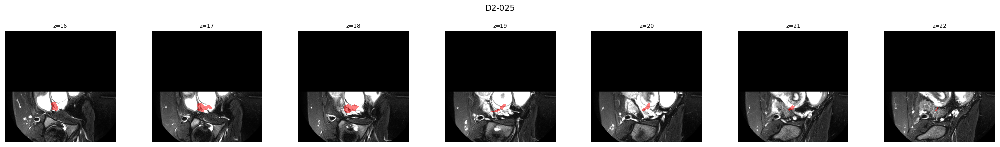

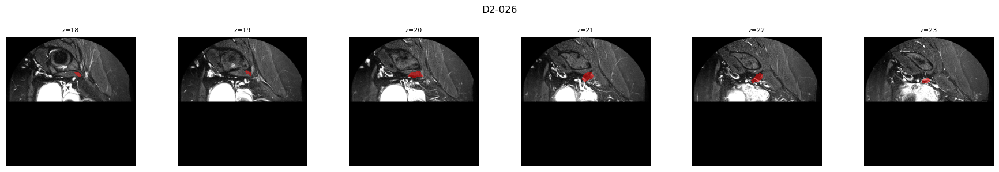

[WARN] D2-027: shape mismatch img (320, 320, 34) vs ov (384, 384, 36), using overlap.


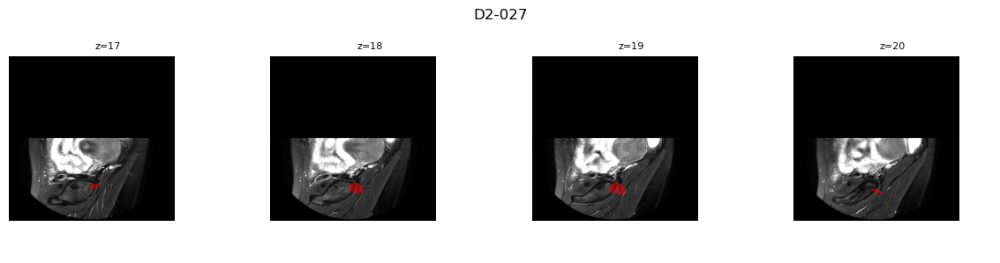

[WARN] D2-028: shape mismatch img (320, 320, 35) vs ov (352, 352, 38), using overlap.


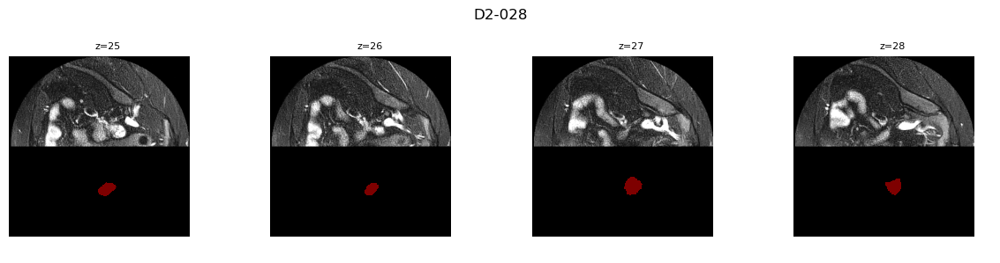

[WARN] D2-029: shape mismatch img (352, 352, 36) vs ov (352, 352, 34), using overlap.


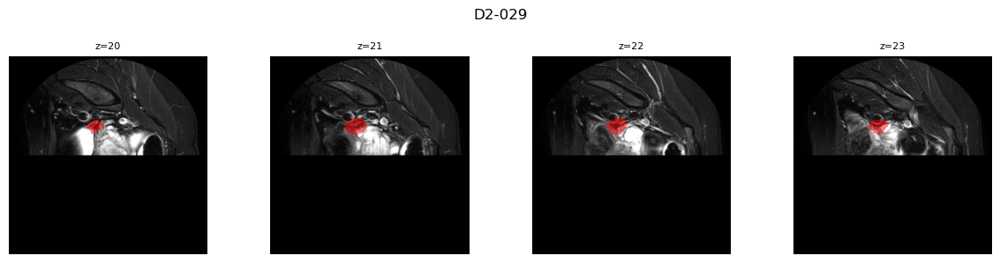

[WARN] D2-038: shape mismatch img (384, 384, 38) vs ov (320, 320, 35), using overlap.


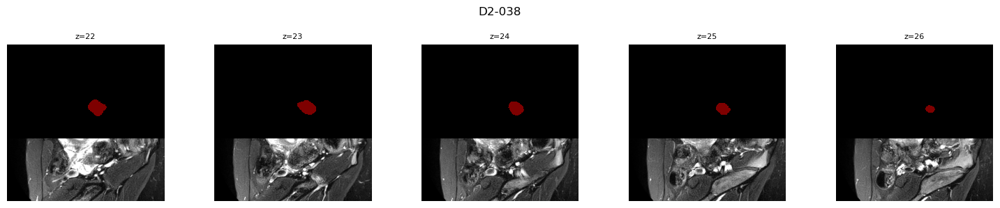

[WARN] D2-043: shape mismatch img (320, 320, 34) vs ov (352, 352, 36), using overlap.


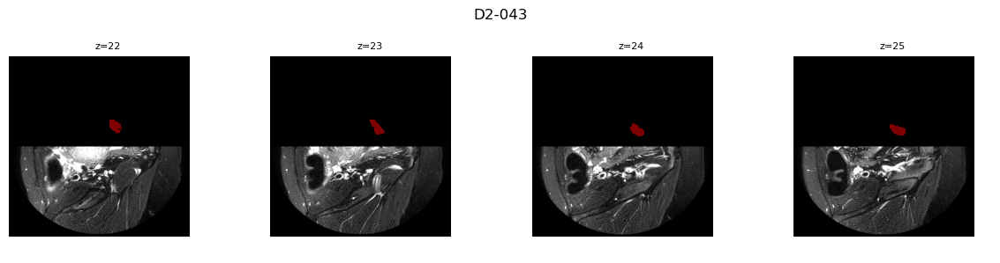

[WARN] D2-044: shape mismatch img (352, 352, 34) vs ov (320, 320, 34), using overlap.


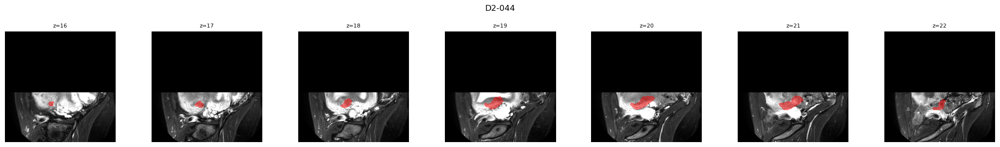

[WARN] D2-046: shape mismatch img (352, 352, 34) vs ov (320, 320, 34), using overlap.


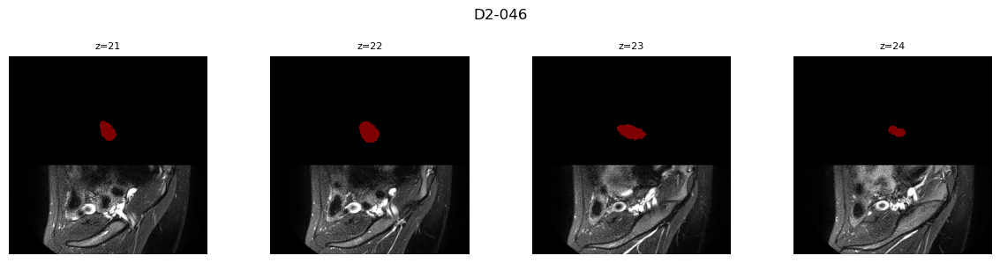

[WARN] D2-047: shape mismatch img (384, 384, 40) vs ov (352, 352, 36), using overlap.


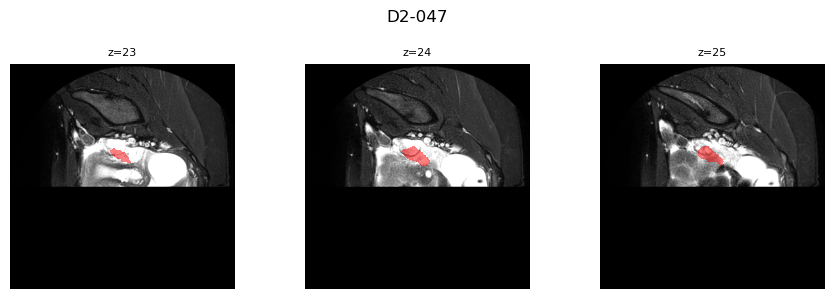

[WARN] D2-048: shape mismatch img (352, 352, 34) vs ov (352, 352, 36), using overlap.


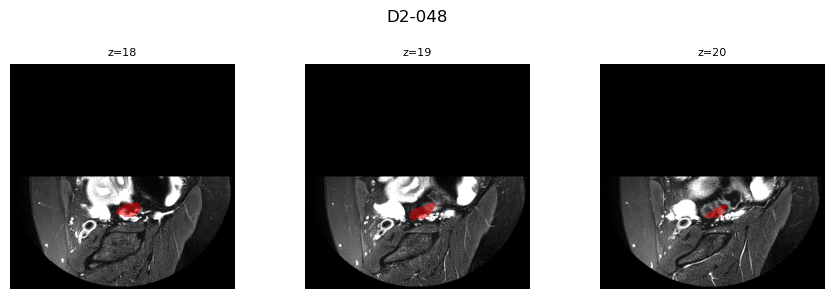

[WARN] D2-051: shape mismatch img (320, 320, 34) vs ov (384, 384, 38), using overlap.


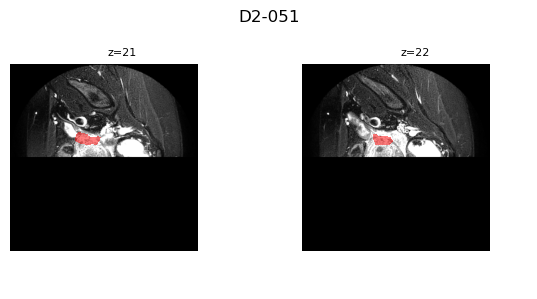

[WARN] D2-052: shape mismatch img (384, 384, 36) vs ov (384, 384, 38), using overlap.


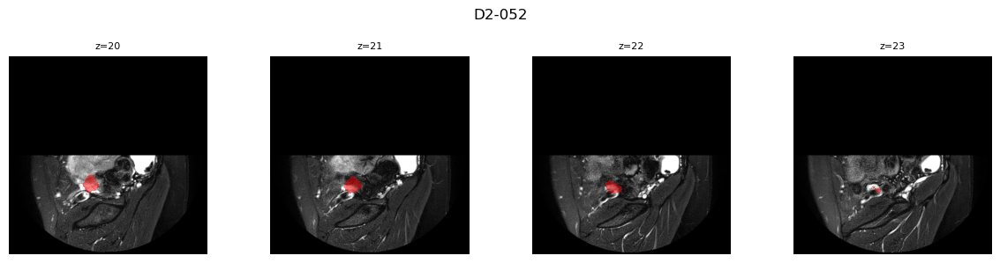

[WARN] D2-055: shape mismatch img (352, 352, 36) vs ov (320, 320, 37), using overlap.


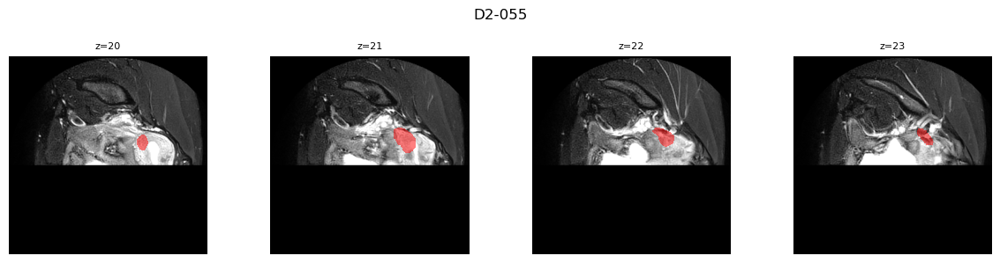

[WARN] D2-057: shape mismatch img (352, 352, 34) vs ov (384, 384, 44), using overlap.


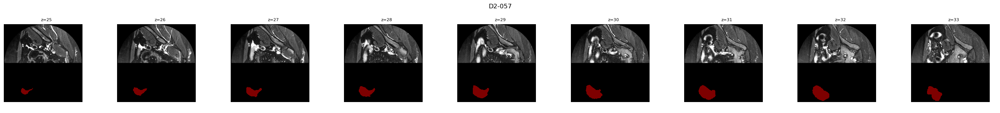

[WARN] D2-058: shape mismatch img (352, 352, 36) vs ov (352, 352, 34), using overlap.


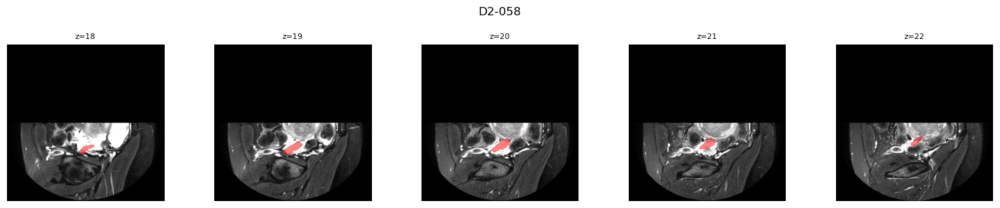

[WARN] D2-059: shape mismatch img (352, 352, 38) vs ov (320, 320, 34), using overlap.


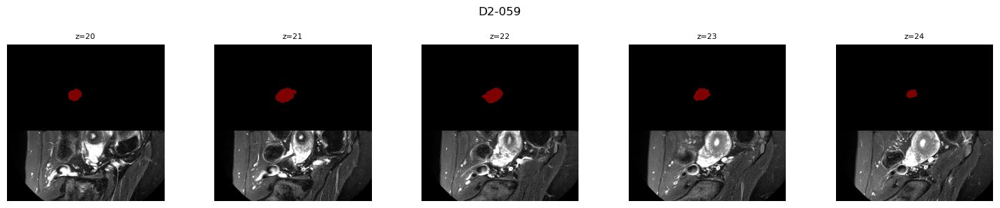

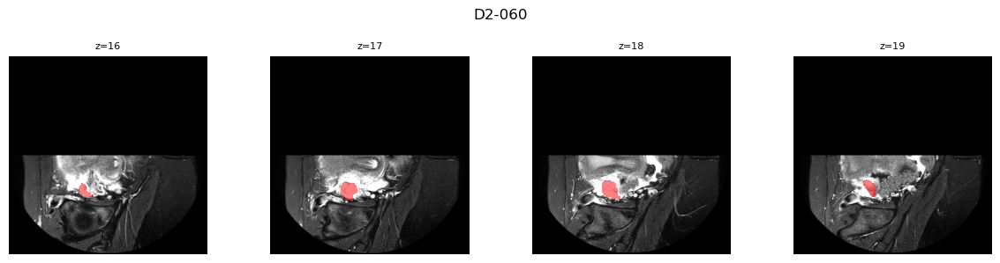

[WARN] D2-061: shape mismatch img (352, 352, 38) vs ov (384, 384, 42), using overlap.


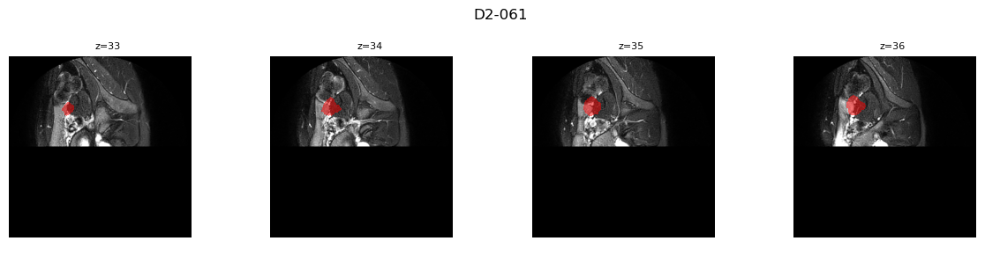

[WARN] D2-065: shape mismatch img (352, 352, 34) vs ov (352, 352, 38), using overlap.


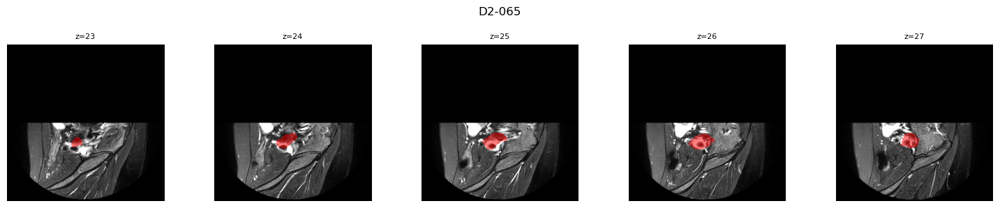

[WARN] D2-073: shape mismatch img (384, 384, 38) vs ov (352, 352, 32), using overlap.


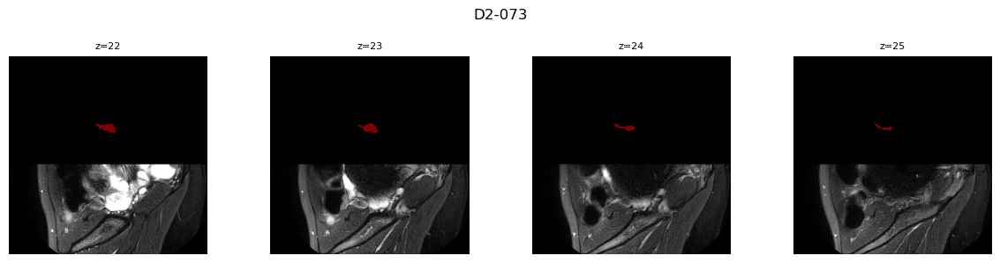

In [2]:
from pathlib import Path
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt

plt.rcParams["figure.figsize"] = (6, 6)

# Adjust if your notebook is not in dlvr-project/notebooks
project_root = Path("..").resolve()
d2_masked_root = project_root / "data" / "UT-EndoMRI" / "D2_TCPW_masked"

print("Masked D2 root:", d2_masked_root)
assert d2_masked_root.is_dir(), f"Masked root not found: {d2_masked_root}"


def load_masked_img_and_ov(pid):
    """
    Load masked T2FS + ov mask for a given patient ID from D2_TCPW_masked.
    """
    patient_dir = d2_masked_root / pid
    img_path = patient_dir / f"{pid}_T2FS_masked.nii.gz"
    ov_path  = patient_dir / f"{pid}_ov.nii.gz"

    assert img_path.exists(), f"Missing masked T2FS for {pid}: {img_path}"
    assert ov_path.exists(),  f"Missing ov mask for {pid}: {ov_path}"

    img_nii = nib.load(str(img_path))
    ov_nii  = nib.load(str(ov_path))

    img = img_nii.get_fdata()
    ov  = ov_nii.get_fdata()

    if img.shape != ov.shape:
        print(f"[WARN] {pid}: shape mismatch img {img.shape} vs ov {ov.shape}, using overlap.")
        # Use overlapping depth if needed
        min_z = min(img.shape[2], ov.shape[2])
        img = img[:, :, :min_z]
        ov  = ov[:, :, :min_z]

    return img, ov


def plot_patient_row_from_masked(pid, vmax_cols=None):
    """
    Plot all slices with non-zero ov mask for a given patient in one row.
    Uses the masked T2FS image from D2_TCPW_masked.
    """
    img, ov = load_masked_img_and_ov(pid)

    H, W, Z = img.shape

    # Find ovary-positive slices
    mask_slice_indices = [z for z in range(Z) if np.any(ov[:, :, z] > 0)]
    if not mask_slice_indices:
        print(f"{pid}: no ovary-positive slices, skipping.")
        return

    if vmax_cols is not None:
        mask_slice_indices = mask_slice_indices[:vmax_cols]

    n_cols = len(mask_slice_indices)

    # Normalize volume for display
    lo, hi = np.percentile(img, [1, 99])
    img_norm = np.clip((img - lo) / (hi - lo + 1e-6), 0, 1)

    fig, axes = plt.subplots(1, n_cols, figsize=(3 * n_cols, 3), squeeze=False)
    axes = axes[0]
    fig.suptitle(f"{pid}", fontsize=12)

    for ax, z in zip(axes, mask_slice_indices):
        sl_img = img_norm[:, :, z]
        sl_ov  = ov[:, :, z]

        ax.imshow(sl_img, cmap="gray")
        if np.any(sl_ov > 0):
            ax.imshow(
                np.ma.masked_where(sl_ov <= 0, sl_ov),
                cmap="autumn",
                alpha=0.5,
            )
        ax.set_axis_off()
        ax.set_title(f"z={z}", fontsize=8)

    plt.tight_layout()
    plt.subplots_adjust(top=0.8)
    plt.show()


# Loop over all masked patients and plot rows
masked_patient_dirs = sorted([p for p in d2_masked_root.iterdir() if p.is_dir()])
print(f"Found {len(masked_patient_dirs)} masked patient folders.")

for patient_dir in masked_patient_dirs:
    pid = patient_dir.name  # e.g. "D2-039"
    plot_patient_row_from_masked(pid, vmax_cols=None)  # or e.g. vmax_cols=8 to limit width
